In [2]:
pip install git+https://github.com/statsmodels/statsmodels

  Cloning https://github.com/statsmodels/statsmodels to /tmp/pip-req-build-hd3tfs4h
  Running command git clone -q https://github.com/statsmodels/statsmodels /tmp/pip-req-build-hd3tfs4h
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
  Created wheel for statsmodels: filename=statsmodels-0.14.0.dev0+70.g718b4c5d8-cp37-cp37m-linux_x86_64.whl size=17856344 sha256=0c1bf8d118cadce56c42882d5de27f0790d3951fc3fc2d75de51c37c59eb84e7
  Stored in directory: /tmp/pip-ephem-wheel-cache-qp26fqep/wheels/a7/e2/12/87eac3fb9bcec178a4228e24f5d4c0996208883c6f1b44e941
Successfully built statsmodels
  Attempting uninstall: statsmodels
    Found existing installation: statsmodels 0.10.2
    Uninstalling statsmodels-0.10.2:
      Successfully uninstalled statsmodels-0.10.2


In [3]:
import pandas            as pd
import matplotlib.pyplot as plt
import matplotlib.dates  as mdates
import seaborn           as sns
import numpy             as np
import statsmodels.api   as sm

from statsmodels.tsa.api       import VAR
from statsmodels.tsa.stattools import adfuller

In [4]:
from google.colab import files
import io
uploaded = files.upload()

Saving Data_final.xlsx to Data_final.xlsx


In [5]:
sns.set_style('whitegrid')
pd.plotting.register_matplotlib_converters()
sns.mpl.rc('figure',figsize=(20, 10))

In [6]:
df = pd.read_excel('Data_final.xlsx')

In [7]:
df.index = pd.date_range(start='01/09/1987', periods=136, freq='Q')
df.drop(df.columns[0], axis=1 , inplace=True)

In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 136 entries, 1987-03-31 to 2020-12-31
Freq: Q-DEC
Data columns (total 20 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   batotalvol            136 non-null    float64
 1   ctotalvol             136 non-null    int64  
 2   dwell_complete        136 non-null    int64  
 3   ipd_natdi             136 non-null    float64
 4   natdi                 136 non-null    int64  
 5   wdnewvol              136 non-null    int64  
 6   cash                  136 non-null    float64
 7   inf_exp               136 non-null    float64
 8   rinc                  136 non-null    float64
 9   rinc_per_capita       136 non-null    float64
 10  i_10y_bond            136 non-null    float64
 11  house_price_index     136 non-null    float64
 12  rrent                 136 non-null    float64
 13  stock                 136 non-null    float64
 14  ur                    136 non-null    float

In [11]:
#Converting all data columns to the same Dtype
df['ctotalvol'] = df['ctotalvol'].astype(np.float64)
df['dwell_complete'] = df['dwell_complete'].astype(np.float64)
df['natdi'] = df['natdi'].astype(np.float64)
df['wdnewvol'] = df['wdnewvol'].astype(np.float64)
df['gdp_aggregate_milaud'] = df['gdp_aggregate_milaud'].astype(np.float64)
df['gdp_per_capita'] = df['gdp_per_capita'].astype(np.float64)

In [12]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 136 entries, 1987-03-31 to 2020-12-31
Freq: Q-DEC
Data columns (total 20 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   batotalvol            136 non-null    float64
 1   ctotalvol             136 non-null    float64
 2   dwell_complete        136 non-null    float64
 3   ipd_natdi             136 non-null    float64
 4   natdi                 136 non-null    float64
 5   wdnewvol              136 non-null    float64
 6   cash                  136 non-null    float64
 7   inf_exp               136 non-null    float64
 8   rinc                  136 non-null    float64
 9   rinc_per_capita       136 non-null    float64
 10  i_10y_bond            136 non-null    float64
 11  house_price_index     136 non-null    float64
 12  rrent                 136 non-null    float64
 13  stock                 136 non-null    float64
 14  ur                    136 non-null    float

#Filling missing values of columns with the median values for minimal estimation bias.

In [13]:
df['dwell_complete'] = df['dwell_complete'].fillna((df['dwell_complete'].median()))
df['wdnewvol'] = df['wdnewvol'].fillna((df['wdnewvol'].median()))
df['inf_exp'] = df['inf_exp'].fillna((df['inf_exp'].median()))
df['stock'] = df['stock'].fillna((df['stock'].median()))
df['house_price_index'] = df['house_price_index'].fillna((df['house_price_index'].median()))
df['ipd_natdi'] = df['ipd_natdi'].fillna((df['ipd_natdi'].median()))
df['cash'] = df['cash'].fillna((df['cash'].median()))
df['mr'] = df['mr'].fillna((df['mr'].median()))

In [14]:
df.head()

,batotalvol,ctotalvol,dwell_complete,ipd_natdi,natdi,wdnewvol,cash,inf_exp,rinc,rinc_per_capita,i_10y_bond,house_price_index,rrent,stock,ur,mr,wap,under,gdp_aggregate_milaud,gdp_per_capita
1987-03-31,6747300.0,6332462.0,28505.0,31.4,10570000.0,5591388.0,12.130667,2.5,1.106517e+08,8816.065395,12.800000,19.300908,40.2,921689750.0,7.978609,15.104167,12551.144353,4.057516,186482.0,11420.0
1987-06-30,7280900.0,6781704.0,31949.0,32.0,11407000.0,6088290.0,11.432333,2.5,1.087794e+08,8621.390418,13.266667,20.225681,41.2,932811575.0,7.914552,14.208333,12617.386117,3.992003,204242.0,12458.0
1987-09-30,7552200.0,6911948.0,27329.0,32.8,10773000.0,5998772.0,10.715333,2.5,1.116384e+08,8798.716244,12.200000,21.120623,42.4,943315250.0,7.516785,13.666667,12688.036147,3.964357,184557.0,11204.0
1987-12-31,8617600.0,7901065.0,31851.0,33.9,11397000.0,6641407.0,12.316667,2.5,1.128438e+08,8848.134076,11.916667,22.254215,43.4,941795000.0,7.649283,13.583333,12753.402290,3.689623,191663.0,11593.0
1988-03-31,9682900.0,9149174.0,34960.0,35.5,13036000.0,7751075.0,12.897333,2.5,1.124363e+08,8774.131824,11.900000,24.431907,44.8,954505100.0,6.919640,14.500000,12814.516267,3.645943,193908.0,11672.0


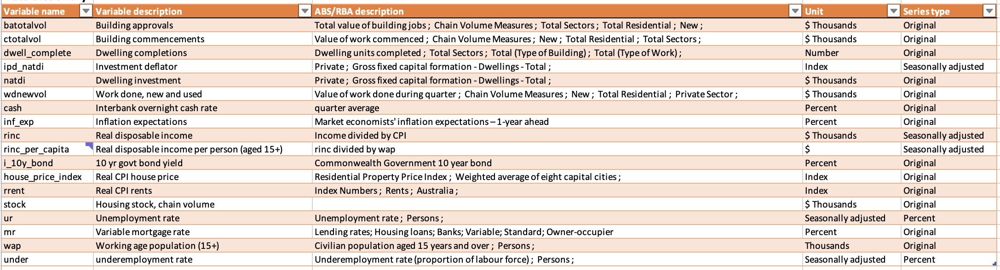

In [17]:
df1 = pd.DataFrame()
df2 = pd.DataFrame()
df3 = pd.DataFrame()
df4 = pd.DataFrame()
df5 = pd.DataFrame()
df6 = pd.DataFrame()
df7 = pd.DataFrame()
df8 = pd.DataFrame()
df9 = pd.DataFrame()
df10 = pd.DataFrame()
df11 = pd.DataFrame()
df12 = pd.DataFrame()
df13 = pd.DataFrame()
df14 = pd.DataFrame()
df15 = pd.DataFrame()
df16 = pd.DataFrame()
df17 = pd.DataFrame()
df18 = pd.DataFrame()
df19 = pd.DataFrame()
df20 = pd.DataFrame()


df1['data'] = df['batotalvol']
df2['data'] = df['ctotalvol']
df3['data'] = df['dwell_complete']
df4['data'] = df['ipd_natdi']
df5['data'] = df['natdi']
df6['data'] = df['wdnewvol']
df7['data'] = df['cash']
df8['data'] = df['inf_exp']
df9['data'] = df['rinc']
df10['data'] = df['rinc_per_capita']
df11['data'] = df['i_10y_bond']
df12['data'] = df['house_price_index']
df13['data'] = df['rrent']
df14['data'] = df['stock']
df15['data'] = df['ur']
df16['data'] = df['mr']
df17['data'] = df['wap']
df18['data'] = df['under']
df19['data'] = df['gdp_aggregate_milaud']
df20['data'] = df['gdp_per_capita']

#Visualising the variables, their moving averages, their detrended values and standard deviations in one function **plot_rolling**

In [18]:
def plot_rolling(df,name):
    
    df['z_data'] = (df['data'] - df.data.rolling(window=4).mean()) / df.data.rolling(window=4).std()
    df['zp_data'] = df['z_data'] - df['z_data'].shift(1)
    df['zs_data'] = df['z_data'] - df['z_data'].shift(4)
    
    fig, ax = plt.subplots(4,figsize=(12, 9))
    ax[0].scatter(df.index, df.data, color='c', label=name)
    ax[0].plot(df.data.rolling(window=4).mean(), color='b', label="moving average");
    ax[0].plot(df.data.rolling(window=4).std(), color='r', label="moving std");
    ax[0].legend()

    ax[1].scatter(df.index, df.z_data, color='c', label="de-trended "+name)
    ax[1].plot(df.z_data.rolling(window=4).mean(), color='b', label="moving average");
    ax[1].plot(df.z_data.rolling(window=4).std(), color='r', label="moving std");
    ax[1].legend()

    ax[2].scatter(df.index, df.zp_data, color='c', label="1 lag differenced de-trended "+name)
    ax[2].plot(df.zp_data.rolling(window=4).mean(), color='b', label="moving average");
    ax[2].plot(df.zp_data.rolling(window=4).std(), color='r', label="moving std");
    ax[2].legend()
    ax[3].scatter(df.index, df.zs_data, color='c', label="seasonal differenced de-trended "+name)
    ax[3].plot(df.zs_data.rolling(window=4).mean(), color='b', label="moving average");
    ax[3].plot(df.zs_data.rolling(window=4).std(), color='r', label="moving std");
    ax[3].legend()

    plt.tight_layout()
    fig.autofmt_xdate()

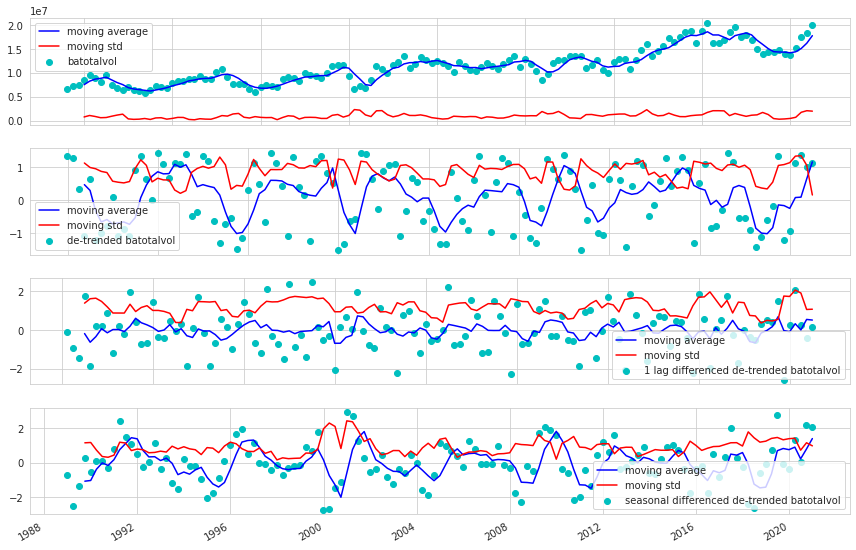

In [19]:
plot_rolling(df1,'batotalvol')

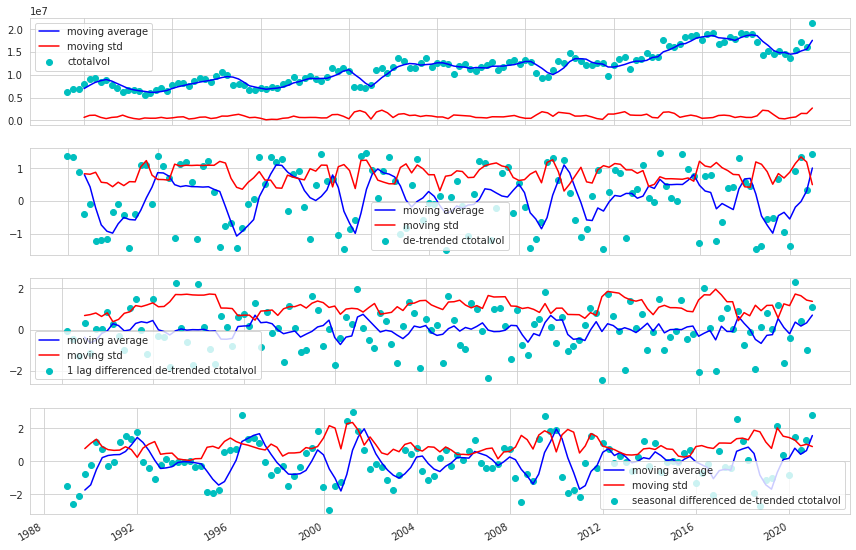

In [ ]:
plot_rolling(df2,'ctotalvol')

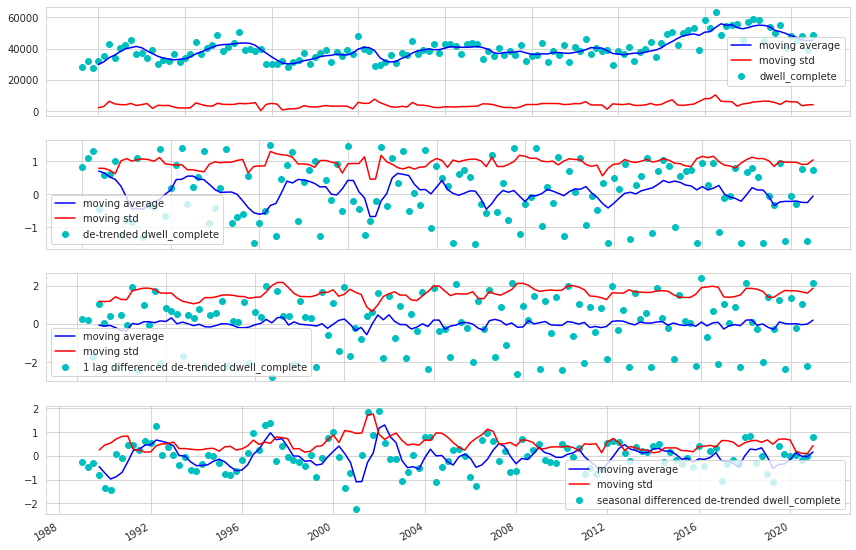

In [ ]:
plot_rolling(df3,'dwell_complete')

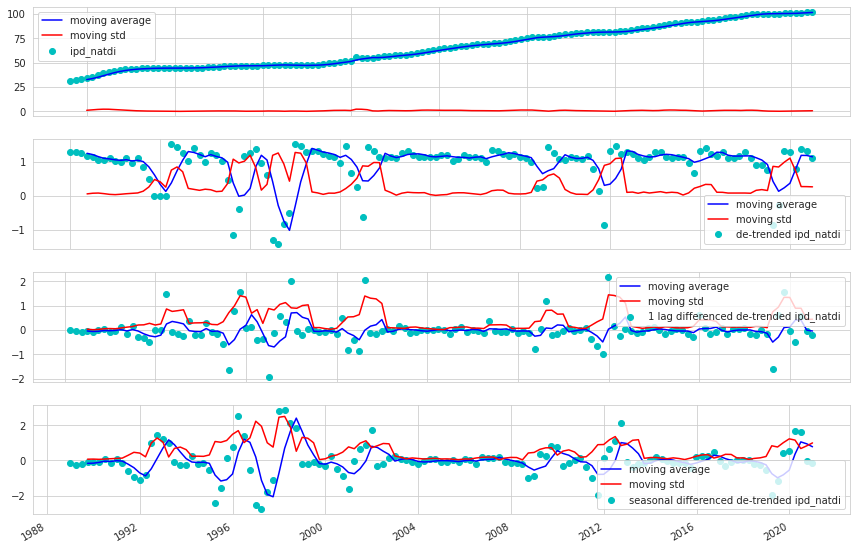

In [ ]:
plot_rolling(df4,'ipd_natdi')

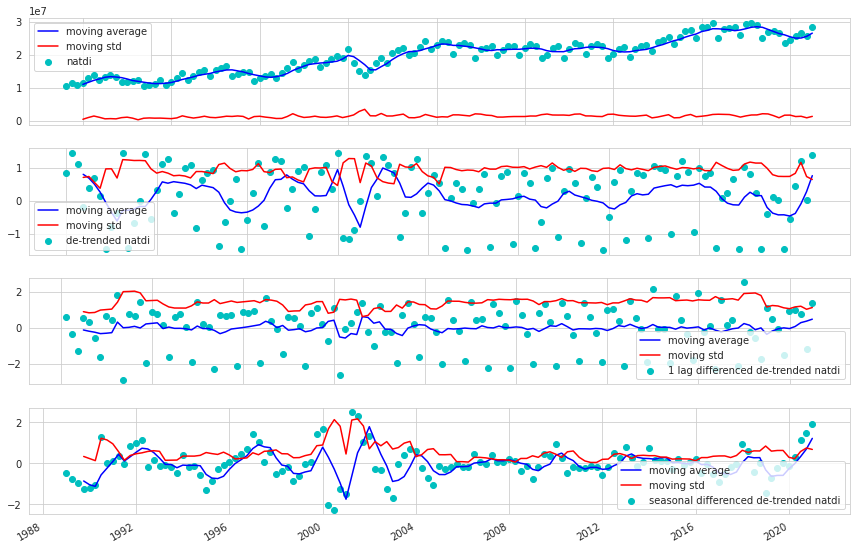

In [ ]:
plot_rolling(df5,'natdi')

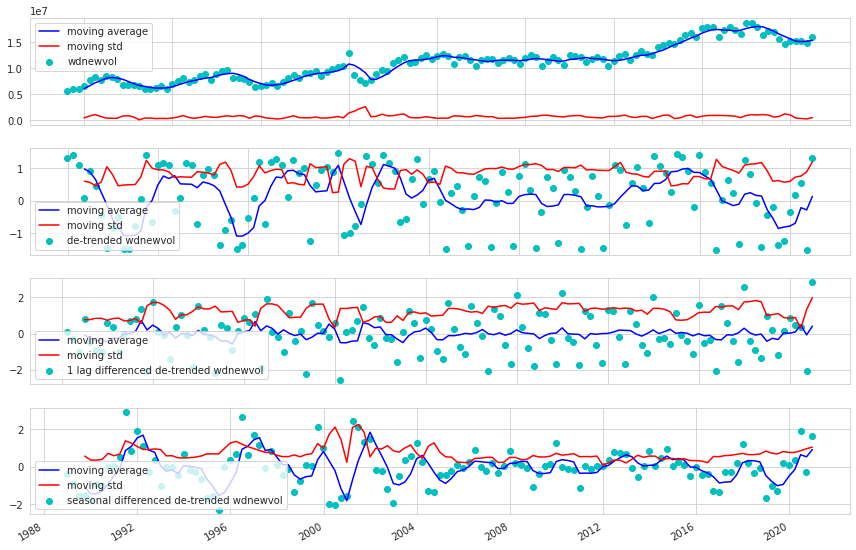

In [ ]:
plot_rolling(df6,'wdnewvol')

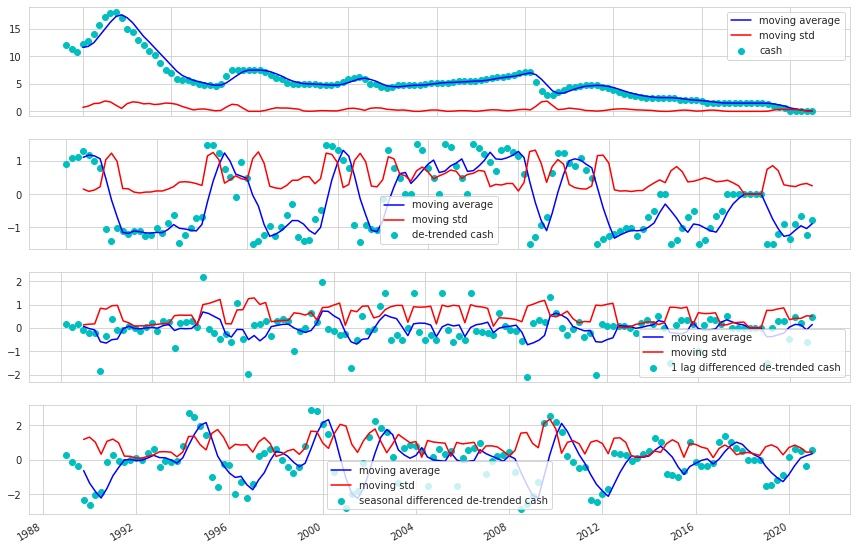

In [ ]:
plot_rolling(df7,'cash')

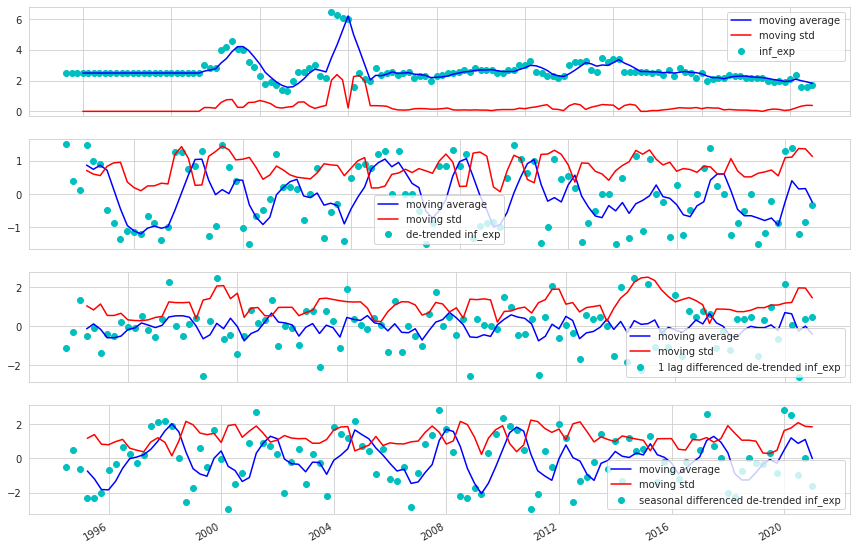

In [ ]:
plot_rolling(df8,'inf_exp')

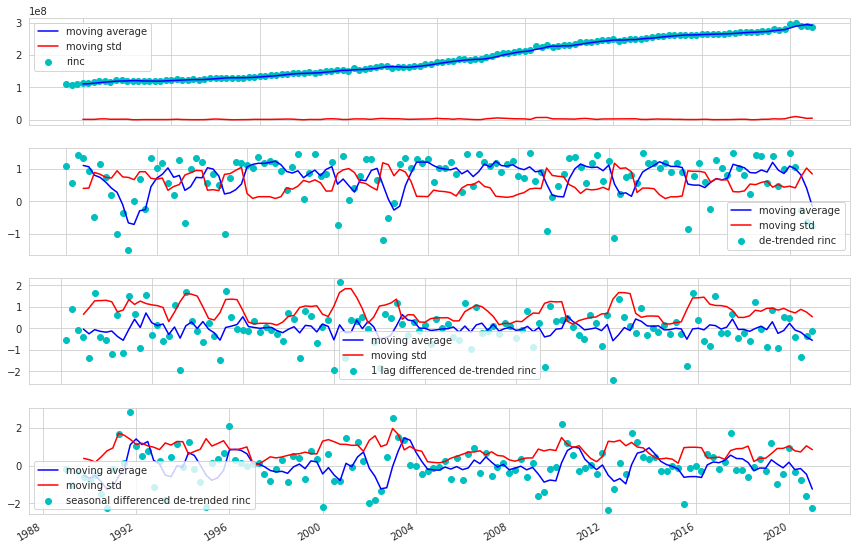

In [ ]:
plot_rolling(df9,'rinc')

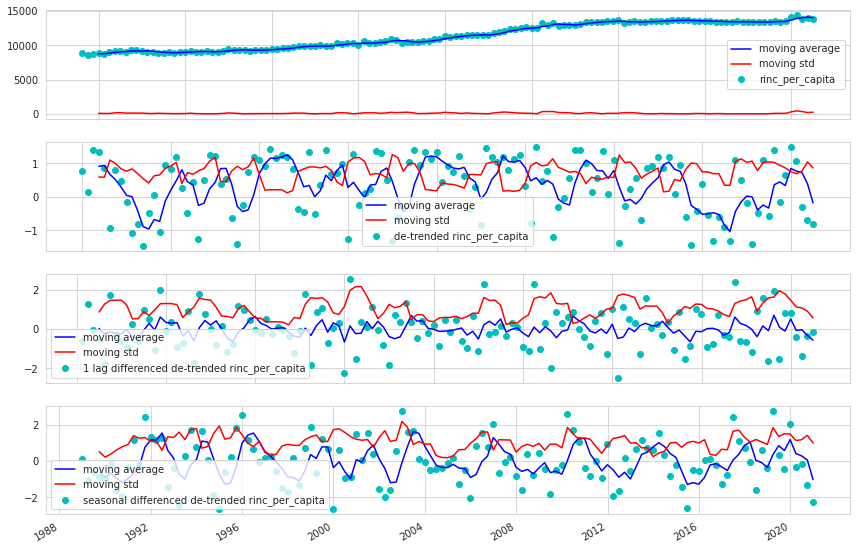

In [ ]:
plot_rolling(df10,'rinc_per_capita')

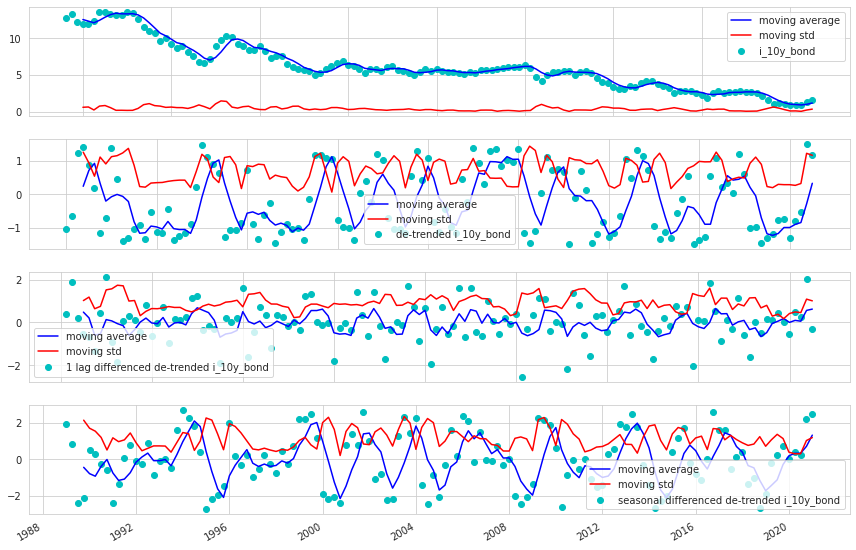

In [ ]:
plot_rolling(df11,'i_10y_bond')

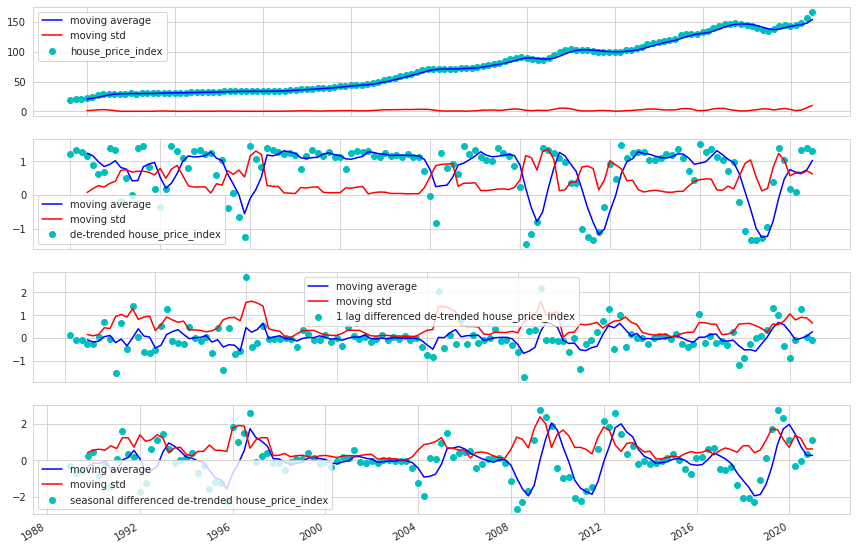

In [ ]:
plot_rolling(df12,'house_price_index')

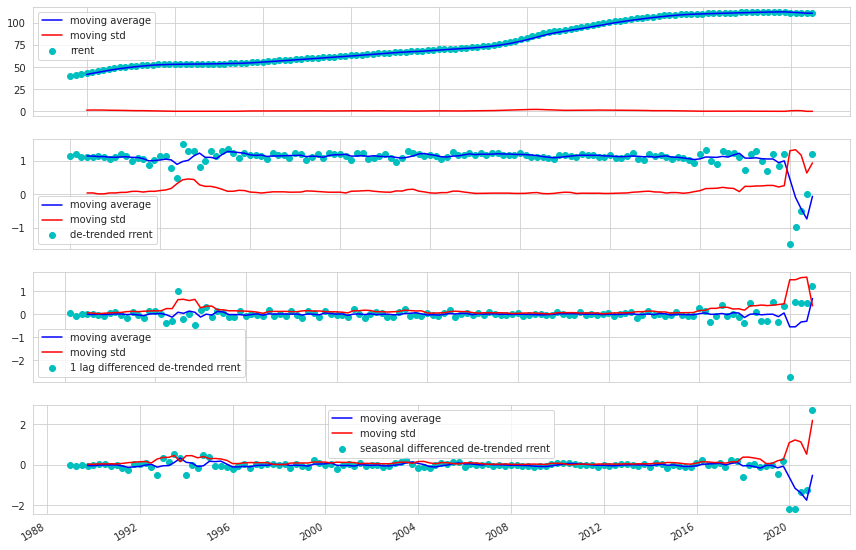

In [ ]:
plot_rolling(df13,'rrent')

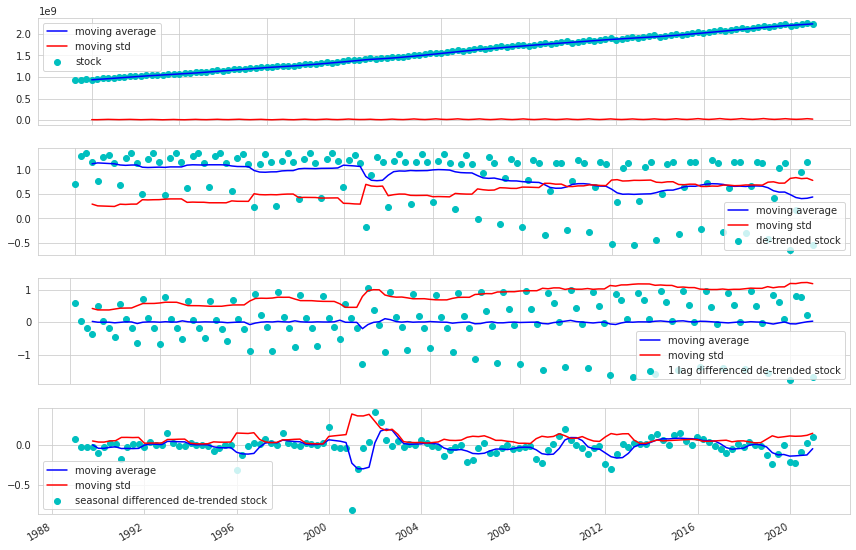

In [ ]:
plot_rolling(df14,'stock')

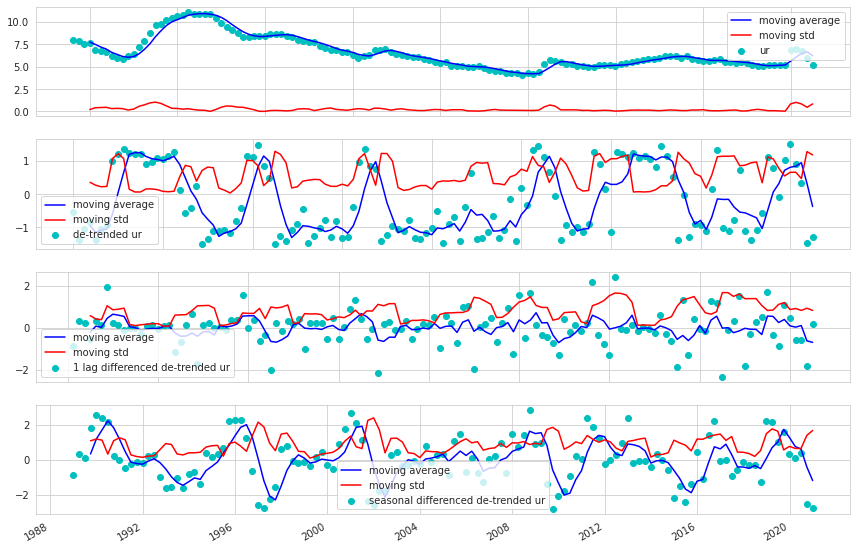

In [ ]:
plot_rolling(df15,'ur')

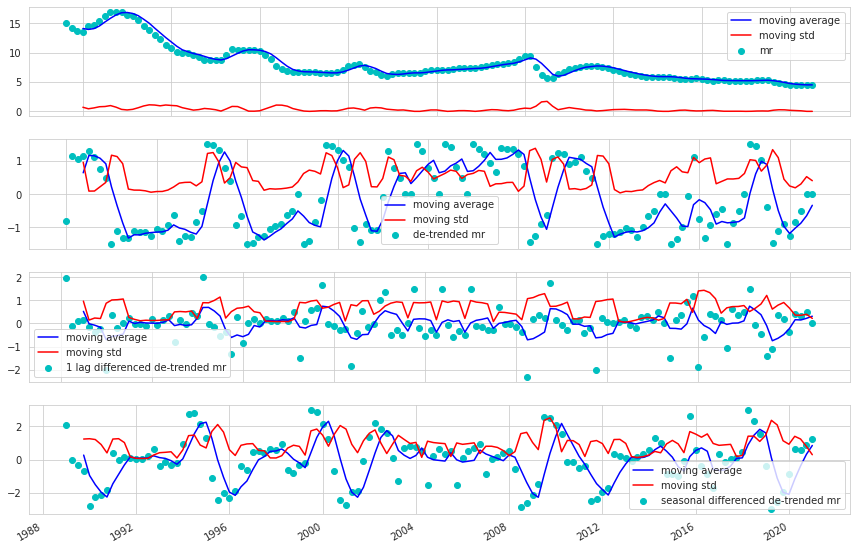

In [ ]:
plot_rolling(df16,'mr')

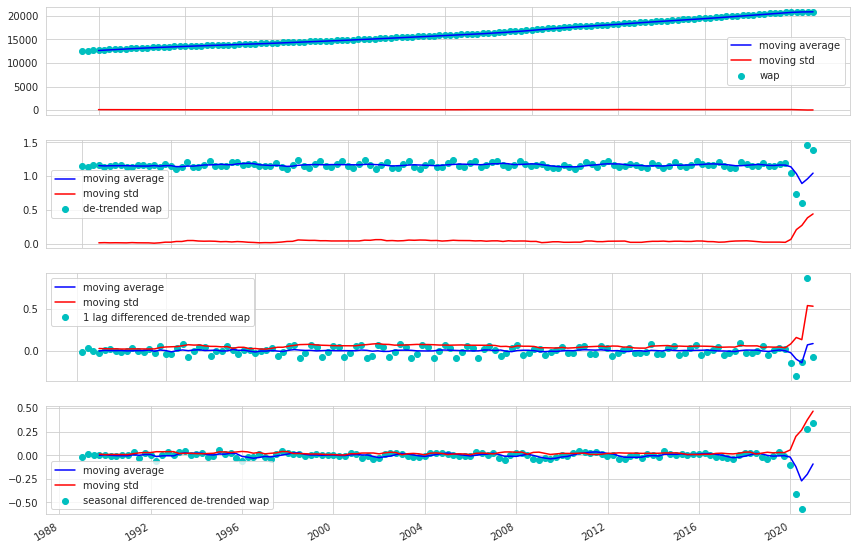

In [ ]:
plot_rolling(df17,'wap')

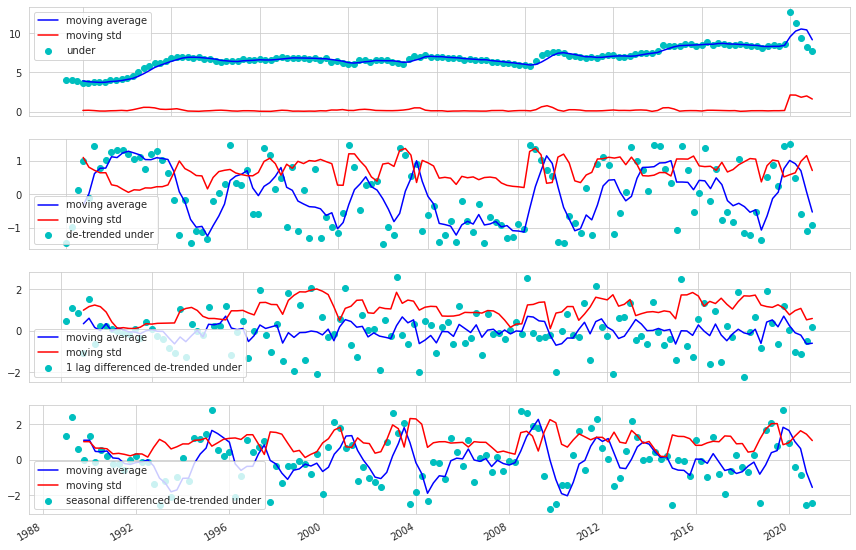

In [ ]:
plot_rolling(df18,'under')

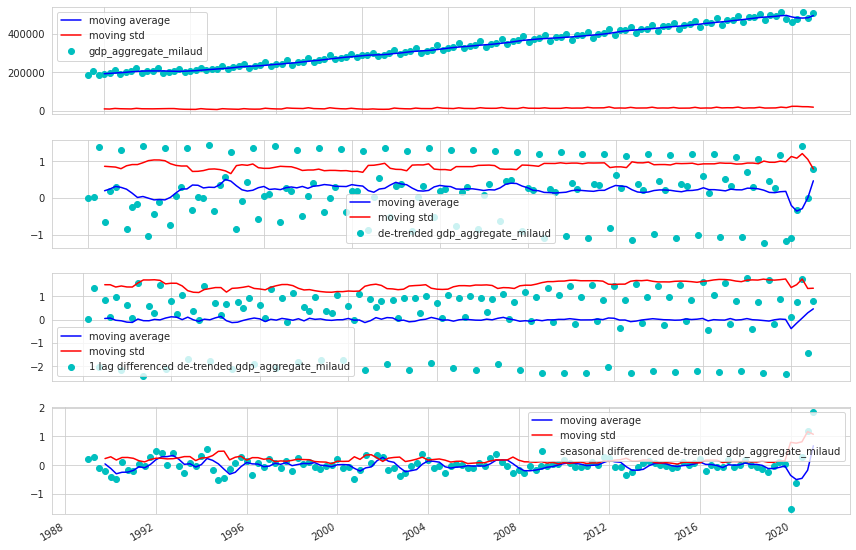

In [ ]:
plot_rolling(df19,'gdp_aggregate_milaud')

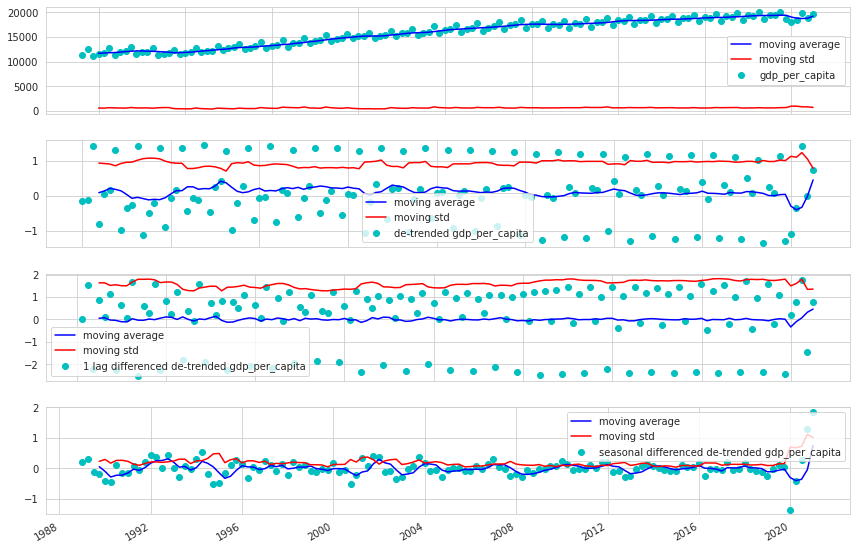

In [ ]:
plot_rolling(df20,'gdp_per_capita')

#Augmented Dickey Fuller Tests of Stationarity for each variable

In [20]:
def adf_test(df,name):
    
    print("-----------------------------------------")
    print("for variable " + name)
    print("-----------------------------------------")
    
    dftest = adfuller(df.data.dropna(), autolag='AIC')
    print("Test statistic = {:.3f}".format(dftest[0]))
    print("P-value = {:.3f}".format(dftest[1]))
    print("Critical values :")
    for k, v in dftest[4].items():
      print("\t{}: {} - The data is {} stationary with {}% confidence".format(k, v, "not" if v<dftest[0] else "", 100-int(k[:-1])))

    print("\n > Is the de-trended data stationary ?")
    dftest = adfuller(df.z_data.dropna(), autolag='AIC')
    print("Test statistic = {:.3f}".format(dftest[0]))
    print("P-value = {:.3f}".format(dftest[1]))
    print("Critical values :")
    for k, v in dftest[4].items():
      print("\t{}: {} - The data is {} stationary with {}% confidence".format(k, v, "not" if v<dftest[0] else "", 100-int(k[:-1])))
    print("\n > Is the 1-lag differenced de-trended data stationary ?")
    dftest = adfuller(df.zp_data.dropna(), autolag='AIC')
    print("Test statistic = {:.3f}".format(dftest[0]))
    print("P-value = {:.3f}".format(dftest[1]))
    print("Critical values :")
    for k, v in dftest[4].items():
      print("\t{}: {} - The data is {} stationary with {}% confidence".format(k, v, "not" if v<dftest[0] else "", 100-int(k[:-1])))
    
    print("\n > Is the seasonal differenced de-trended data stationary ?")
    dftest = adfuller(df.zs_data.dropna(), autolag='AIC')
    print("Test statistic = {:.3f}".format(dftest[0]))
    print("P-value = {:.3f}".format(dftest[1]))
    print("Critical values :")
    for k, v in dftest[4].items():
      print("\t{}: {} - The data is {} stationary with {}% confidence".format(k, v, "not" if v<dftest[0] else "", 100-int(k[:-1])))

In [21]:
adf_test(df1, 'batotalvol')

-----------------------------------------
for variable batotalvol
-----------------------------------------
Test statistic = -0.524
P-value = 0.887
Critical values :
	1%: -3.4833462346078936 - The data is not stationary with 99% confidence
	5%: -2.8847655969877666 - The data is not stationary with 95% confidence
	10%: -2.5791564575459813 - The data is not stationary with 90% confidence

 > Is the de-trended data stationary ?
Test statistic = -5.279
P-value = 0.000
Critical values :
	1%: -3.4865346059036564 - The data is  stationary with 99% confidence
	5%: -2.8861509858476264 - The data is  stationary with 95% confidence
	10%: -2.579896092790057 - The data is  stationary with 90% confidence

 > Is the 1-lag differenced de-trended data stationary ?
Test statistic = -4.425
P-value = 0.000
Critical values :
	1%: -3.4870216863700767 - The data is  stationary with 99% confidence
	5%: -2.8863625166643136 - The data is  stationary with 95% confidence
	10%: -2.580009026141913 - The data is  st

In [ ]:
adf_test(df2, 'ctotalvol')

-----------------------------------------
for variable ctotalvol
-----------------------------------------
Test statistic = -0.276
P-value = 0.929
Critical values :
	1%: -3.4837793736959997 - The data is not stationary with 99% confidence
	5%: -2.88495387648 - The data is not stationary with 95% confidence
	10%: -2.579256976 - The data is not stationary with 90% confidence

 > Is the de-trended data stationary ?
Test statistic = -5.549
P-value = 0.000
Critical values :
	1%: -3.4865346059036564 - The data is  stationary with 99% confidence
	5%: -2.8861509858476264 - The data is  stationary with 95% confidence
	10%: -2.579896092790057 - The data is  stationary with 90% confidence

 > Is the 1-lag differenced de-trended data stationary ?
Test statistic = -5.932
P-value = 0.000
Critical values :
	1%: -3.4851223522012855 - The data is  stationary with 99% confidence
	5%: -2.88553750045158 - The data is  stationary with 95% confidence
	10%: -2.5795685622144586 - The data is  stationary with 

In [ ]:
adf_test(df3, 'dwell_complete')

-----------------------------------------
for variable dwell_complete
-----------------------------------------
Test statistic = -1.542
P-value = 0.513
Critical values :
	1%: -3.4846672514209773 - The data is not stationary with 99% confidence
	5%: -2.8853397507076006 - The data is not stationary with 95% confidence
	10%: -2.5794629869786503 - The data is not stationary with 90% confidence

 > Is the de-trended data stationary ?
Test statistic = -4.574
P-value = 0.000
Critical values :
	1%: -3.486055829282407 - The data is  stationary with 99% confidence
	5%: -2.8859430324074076 - The data is  stationary with 95% confidence
	10%: -2.5797850694444446 - The data is  stationary with 90% confidence

 > Is the 1-lag differenced de-trended data stationary ?
Test statistic = -5.798
P-value = 0.000
Critical values :
	1%: -3.485585145896754 - The data is  stationary with 99% confidence
	5%: -2.885738566292665 - The data is  stationary with 95% confidence
	10%: -2.5796759080663887 - The data is 

In [ ]:
adf_test(df4, 'ipd_natdi')

-----------------------------------------
for variable ipd_natdi
-----------------------------------------
Test statistic = -0.036
P-value = 0.955
Critical values :
	1%: -3.480500383888377 - The data is not stationary with 99% confidence
	5%: -2.8835279559405045 - The data is not stationary with 95% confidence
	10%: -2.578495716547007 - The data is not stationary with 90% confidence

 > Is the de-trended data stationary ?
Test statistic = -6.812
P-value = 0.000
Critical values :
	1%: -3.481281802271349 - The data is  stationary with 99% confidence
	5%: -2.883867891664528 - The data is  stationary with 95% confidence
	10%: -2.5786771965503177 - The data is  stationary with 90% confidence

 > Is the 1-lag differenced de-trended data stationary ?
Test statistic = -7.965
P-value = 0.000
Critical values :
	1%: -3.4833462346078936 - The data is  stationary with 99% confidence
	5%: -2.8847655969877666 - The data is  stationary with 95% confidence
	10%: -2.5791564575459813 - The data is  stati

In [ ]:
adf_test(df5, 'natdi')

-----------------------------------------
for variable natdi
-----------------------------------------
Test statistic = -0.725
P-value = 0.840
Critical values :
	1%: -3.4833462346078936 - The data is not stationary with 99% confidence
	5%: -2.8847655969877666 - The data is not stationary with 95% confidence
	10%: -2.5791564575459813 - The data is not stationary with 90% confidence

 > Is the de-trended data stationary ?
Test statistic = -4.851
P-value = 0.000
Critical values :
	1%: -3.486055829282407 - The data is  stationary with 99% confidence
	5%: -2.8859430324074076 - The data is  stationary with 95% confidence
	10%: -2.5797850694444446 - The data is  stationary with 90% confidence

 > Is the 1-lag differenced de-trended data stationary ?
Test statistic = -4.441
P-value = 0.000
Critical values :
	1%: -3.4865346059036564 - The data is  stationary with 99% confidence
	5%: -2.8861509858476264 - The data is  stationary with 95% confidence
	10%: -2.579896092790057 - The data is  station

In [ ]:
adf_test(df6, 'wdnewvol')

-----------------------------------------
for variable wdnewvol
-----------------------------------------
Test statistic = -0.712
P-value = 0.844
Critical values :
	1%: -3.4833462346078936 - The data is not stationary with 99% confidence
	5%: -2.8847655969877666 - The data is not stationary with 95% confidence
	10%: -2.5791564575459813 - The data is not stationary with 90% confidence

 > Is the de-trended data stationary ?
Test statistic = -4.337
P-value = 0.000
Critical values :
	1%: -3.486055829282407 - The data is  stationary with 99% confidence
	5%: -2.8859430324074076 - The data is  stationary with 95% confidence
	10%: -2.5797850694444446 - The data is  stationary with 90% confidence

 > Is the 1-lag differenced de-trended data stationary ?
Test statistic = -5.343
P-value = 0.000
Critical values :
	1%: -3.484219653271961 - The data is  stationary with 99% confidence
	5%: -2.885145235641637 - The data is  stationary with 95% confidence
	10%: -2.579359138917794 - The data is  statio

In [ ]:
adf_test(df7, 'cash')

-----------------------------------------
for variable cash
-----------------------------------------
Test statistic = -1.700
P-value = 0.431
Critical values :
	1%: -3.480500383888377 - The data is not stationary with 99% confidence
	5%: -2.8835279559405045 - The data is not stationary with 95% confidence
	10%: -2.578495716547007 - The data is not stationary with 90% confidence

 > Is the de-trended data stationary ?
Test statistic = -4.523
P-value = 0.000
Critical values :
	1%: -3.481281802271349 - The data is  stationary with 99% confidence
	5%: -2.883867891664528 - The data is  stationary with 95% confidence
	10%: -2.5786771965503177 - The data is  stationary with 90% confidence

 > Is the 1-lag differenced de-trended data stationary ?
Test statistic = -8.898
P-value = 0.000
Critical values :
	1%: -3.4816817173418295 - The data is  stationary with 99% confidence
	5%: -2.8840418343195267 - The data is  stationary with 95% confidence
	10%: -2.578770059171598 - The data is  stationary 

In [ ]:
adf_test(df8, 'inf_exp')

-----------------------------------------
for variable inf_exp
-----------------------------------------
Test statistic = -4.543
P-value = 0.000
Critical values :
	1%: -3.4825006939887997 - The data is  stationary with 99% confidence
	5%: -2.884397984161377 - The data is  stationary with 95% confidence
	10%: -2.578960197753906 - The data is  stationary with 90% confidence

 > Is the de-trended data stationary ?
Test statistic = -7.459
P-value = 0.000
Critical values :
	1%: -3.4912451337340342 - The data is  stationary with 99% confidence
	5%: -2.8881954545454547 - The data is  stationary with 95% confidence
	10%: -2.5809876033057852 - The data is  stationary with 90% confidence

 > Is the 1-lag differenced de-trended data stationary ?
Test statistic = -6.204
P-value = 0.000
Critical values :
	1%: -3.497501033 - The data is  stationary with 99% confidence
	5%: -2.89090644 - The data is  stationary with 95% confidence
	10%: -2.5824349 - The data is  stationary with 90% confidence

 > Is 

In [ ]:
adf_test(df9, 'rinc')

-----------------------------------------
for variable rinc
-----------------------------------------
Test statistic = 0.651
P-value = 0.989
Critical values :
	1%: -3.480118600110386 - The data is not stationary with 99% confidence
	5%: -2.8833618426136196 - The data is not stationary with 95% confidence
	10%: -2.578407034974382 - The data is not stationary with 90% confidence

 > Is the de-trended data stationary ?
Test statistic = -8.608
P-value = 0.000
Critical values :
	1%: -3.4808880719210005 - The data is  stationary with 99% confidence
	5%: -2.8836966192225284 - The data is  stationary with 95% confidence
	10%: -2.5785857598714417 - The data is  stationary with 90% confidence

 > Is the 1-lag differenced de-trended data stationary ?
Test statistic = -6.418
P-value = 0.000
Critical values :
	1%: -3.4846672514209773 - The data is  stationary with 99% confidence
	5%: -2.8853397507076006 - The data is  stationary with 95% confidence
	10%: -2.5794629869786503 - The data is  stationar

In [ ]:
adf_test(df10, 'rinc_per_capita')

-----------------------------------------
for variable rinc_per_capita
-----------------------------------------
Test statistic = -0.648
P-value = 0.860
Critical values :
	1%: -3.480118600110386 - The data is not stationary with 99% confidence
	5%: -2.8833618426136196 - The data is not stationary with 95% confidence
	10%: -2.578407034974382 - The data is not stationary with 90% confidence

 > Is the de-trended data stationary ?
Test statistic = -8.223
P-value = 0.000
Critical values :
	1%: -3.4808880719210005 - The data is  stationary with 99% confidence
	5%: -2.8836966192225284 - The data is  stationary with 95% confidence
	10%: -2.5785857598714417 - The data is  stationary with 90% confidence

 > Is the 1-lag differenced de-trended data stationary ?
Test statistic = -5.878
P-value = 0.000
Critical values :
	1%: -3.4865346059036564 - The data is  stationary with 99% confidence
	5%: -2.8861509858476264 - The data is  stationary with 95% confidence
	10%: -2.579896092790057 - The data is

In [ ]:
adf_test(df11, 'i_10y_bond')

-----------------------------------------
for variable i_10y_bond
-----------------------------------------
Test statistic = -2.595
P-value = 0.094
Critical values :
	1%: -3.4851223522012855 - The data is not stationary with 99% confidence
	5%: -2.88553750045158 - The data is not stationary with 95% confidence
	10%: -2.5795685622144586 - The data is  stationary with 90% confidence

 > Is the de-trended data stationary ?
Test statistic = -6.155
P-value = 0.000
Critical values :
	1%: -3.482087964046026 - The data is  stationary with 99% confidence
	5%: -2.8842185101614626 - The data is  stationary with 95% confidence
	10%: -2.578864381347275 - The data is  stationary with 90% confidence

 > Is the 1-lag differenced de-trended data stationary ?
Test statistic = -5.928
P-value = 0.000
Critical values :
	1%: -3.4870216863700767 - The data is  stationary with 99% confidence
	5%: -2.8863625166643136 - The data is  stationary with 95% confidence
	10%: -2.580009026141913 - The data is  stationa

In [ ]:
adf_test(df12, 'house_price_index')

-----------------------------------------
for variable house_price_index
-----------------------------------------
Test statistic = 1.976
P-value = 0.999
Critical values :
	1%: -3.4825006939887997 - The data is not stationary with 99% confidence
	5%: -2.884397984161377 - The data is not stationary with 95% confidence
	10%: -2.578960197753906 - The data is not stationary with 90% confidence

 > Is the de-trended data stationary ?
Test statistic = -5.262
P-value = 0.000
Critical values :
	1%: -3.4816817173418295 - The data is  stationary with 99% confidence
	5%: -2.8840418343195267 - The data is  stationary with 95% confidence
	10%: -2.578770059171598 - The data is  stationary with 90% confidence

 > Is the 1-lag differenced de-trended data stationary ?
Test statistic = -6.492
P-value = 0.000
Critical values :
	1%: -3.4846672514209773 - The data is  stationary with 99% confidence
	5%: -2.8853397507076006 - The data is  stationary with 95% confidence
	10%: -2.5794629869786503 - The data i

In [ ]:
adf_test(df13, 'rrent')

-----------------------------------------
for variable rrent
-----------------------------------------
Test statistic = -0.103
P-value = 0.949
Critical values :
	1%: -3.482087964046026 - The data is not stationary with 99% confidence
	5%: -2.8842185101614626 - The data is not stationary with 95% confidence
	10%: -2.578864381347275 - The data is not stationary with 90% confidence

 > Is the de-trended data stationary ?
Test statistic = -0.685
P-value = 0.850
Critical values :
	1%: -3.485585145896754 - The data is not stationary with 99% confidence
	5%: -2.885738566292665 - The data is not stationary with 95% confidence
	10%: -2.5796759080663887 - The data is not stationary with 90% confidence

 > Is the 1-lag differenced de-trended data stationary ?
Test statistic = -5.954
P-value = 0.000
Critical values :
	1%: -3.4837793736959997 - The data is  stationary with 99% confidence
	5%: -2.88495387648 - The data is  stationary with 95% confidence
	10%: -2.579256976 - The data is  stationary w

In [ ]:
adf_test(df14, 'stock')

-----------------------------------------
for variable stock
-----------------------------------------
Test statistic = 0.735
P-value = 0.991
Critical values :
	1%: -3.4833462346078936 - The data is not stationary with 99% confidence
	5%: -2.8847655969877666 - The data is not stationary with 95% confidence
	10%: -2.5791564575459813 - The data is not stationary with 90% confidence

 > Is the de-trended data stationary ?
Test statistic = -0.526
P-value = 0.887
Critical values :
	1%: -3.4837793736959997 - The data is not stationary with 99% confidence
	5%: -2.88495387648 - The data is not stationary with 95% confidence
	10%: -2.579256976 - The data is not stationary with 90% confidence

 > Is the 1-lag differenced de-trended data stationary ?
Test statistic = -6.641
P-value = 0.000
Critical values :
	1%: -3.4837793736959997 - The data is  stationary with 99% confidence
	5%: -2.88495387648 - The data is  stationary with 95% confidence
	10%: -2.579256976 - The data is  stationary with 90% c

In [ ]:
adf_test(df15, 'ur')

-----------------------------------------
for variable ur
-----------------------------------------
Test statistic = -1.608
P-value = 0.480
Critical values :
	1%: -3.480118600110386 - The data is not stationary with 99% confidence
	5%: -2.8833618426136196 - The data is not stationary with 95% confidence
	10%: -2.578407034974382 - The data is not stationary with 90% confidence

 > Is the de-trended data stationary ?
Test statistic = -5.007
P-value = 0.000
Critical values :
	1%: -3.4808880719210005 - The data is  stationary with 99% confidence
	5%: -2.8836966192225284 - The data is  stationary with 95% confidence
	10%: -2.5785857598714417 - The data is  stationary with 90% confidence

 > Is the 1-lag differenced de-trended data stationary ?
Test statistic = -8.314
P-value = 0.000
Critical values :
	1%: -3.482087964046026 - The data is  stationary with 99% confidence
	5%: -2.8842185101614626 - The data is  stationary with 95% confidence
	10%: -2.578864381347275 - The data is  stationary w

In [ ]:
adf_test(df16, 'mr')

-----------------------------------------
for variable mr
-----------------------------------------
Test statistic = -3.590
P-value = 0.006
Critical values :
	1%: -3.482920063655088 - The data is  stationary with 99% confidence
	5%: -2.884580323367261 - The data is  stationary with 95% confidence
	10%: -2.5790575441750883 - The data is  stationary with 90% confidence

 > Is the de-trended data stationary ?
Test statistic = -4.907
P-value = 0.000
Critical values :
	1%: -3.481281802271349 - The data is  stationary with 99% confidence
	5%: -2.883867891664528 - The data is  stationary with 95% confidence
	10%: -2.5786771965503177 - The data is  stationary with 90% confidence

 > Is the 1-lag differenced de-trended data stationary ?
Test statistic = -6.725
P-value = 0.000
Critical values :
	1%: -3.484219653271961 - The data is  stationary with 99% confidence
	5%: -2.885145235641637 - The data is  stationary with 95% confidence
	10%: -2.579359138917794 - The data is  stationary with 90% conf

In [ ]:
adf_test(df17, 'wap')

-----------------------------------------
for variable wap
-----------------------------------------
Test statistic = 0.488
P-value = 0.984
Critical values :
	1%: -3.4851223522012855 - The data is not stationary with 99% confidence
	5%: -2.88553750045158 - The data is not stationary with 95% confidence
	10%: -2.5795685622144586 - The data is not stationary with 90% confidence

 > Is the de-trended data stationary ?
Test statistic = -1.524
P-value = 0.522
Critical values :
	1%: -3.484219653271961 - The data is not stationary with 99% confidence
	5%: -2.885145235641637 - The data is not stationary with 95% confidence
	10%: -2.579359138917794 - The data is not stationary with 90% confidence

 > Is the 1-lag differenced de-trended data stationary ?
Test statistic = -2.925
P-value = 0.042
Critical values :
	1%: -3.485585145896754 - The data is not stationary with 99% confidence
	5%: -2.885738566292665 - The data is  stationary with 95% confidence
	10%: -2.5796759080663887 - The data is  sta

In [ ]:
adf_test(df18, 'under')

-----------------------------------------
for variable under
-----------------------------------------
Test statistic = -2.500
P-value = 0.116
Critical values :
	1%: -3.479742586699182 - The data is not stationary with 99% confidence
	5%: -2.88319822181578 - The data is not stationary with 95% confidence
	10%: -2.578319684499314 - The data is not stationary with 90% confidence

 > Is the de-trended data stationary ?
Test statistic = -5.112
P-value = 0.000
Critical values :
	1%: -3.481281802271349 - The data is  stationary with 99% confidence
	5%: -2.883867891664528 - The data is  stationary with 95% confidence
	10%: -2.5786771965503177 - The data is  stationary with 90% confidence

 > Is the 1-lag differenced de-trended data stationary ?
Test statistic = -7.188
P-value = 0.000
Critical values :
	1%: -3.484219653271961 - The data is  stationary with 99% confidence
	5%: -2.885145235641637 - The data is  stationary with 95% confidence
	10%: -2.579359138917794 - The data is  stationary wit

In [ ]:
adf_test(df19, 'gdp_aggregate_milaud')

-----------------------------------------
for variable gdp_aggregate_milaud
-----------------------------------------
Test statistic = 0.921
P-value = 0.993
Critical values :
	1%: -3.482920063655088 - The data is not stationary with 99% confidence
	5%: -2.884580323367261 - The data is not stationary with 95% confidence
	10%: -2.5790575441750883 - The data is not stationary with 90% confidence

 > Is the de-trended data stationary ?
Test statistic = -3.605
P-value = 0.006
Critical values :
	1%: -3.486055829282407 - The data is  stationary with 99% confidence
	5%: -2.8859430324074076 - The data is  stationary with 95% confidence
	10%: -2.5797850694444446 - The data is  stationary with 90% confidence

 > Is the 1-lag differenced de-trended data stationary ?
Test statistic = -5.397
P-value = 0.000
Critical values :
	1%: -3.4870216863700767 - The data is  stationary with 99% confidence
	5%: -2.8863625166643136 - The data is  stationary with 95% confidence
	10%: -2.580009026141913 - The data

In [ ]:
adf_test(df20, 'gdp_per_capita')

-----------------------------------------
for variable gdp_per_capita
-----------------------------------------
Test statistic = -0.863
P-value = 0.800
Critical values :
	1%: -3.482920063655088 - The data is not stationary with 99% confidence
	5%: -2.884580323367261 - The data is not stationary with 95% confidence
	10%: -2.5790575441750883 - The data is not stationary with 90% confidence

 > Is the de-trended data stationary ?
Test statistic = -3.062
P-value = 0.030
Critical values :
	1%: -3.486055829282407 - The data is not stationary with 99% confidence
	5%: -2.8859430324074076 - The data is  stationary with 95% confidence
	10%: -2.5797850694444446 - The data is  stationary with 90% confidence

 > Is the 1-lag differenced de-trended data stationary ?
Test statistic = -5.311
P-value = 0.000
Critical values :
	1%: -3.4870216863700767 - The data is  stationary with 99% confidence
	5%: -2.8863625166643136 - The data is  stationary with 95% confidence
	10%: -2.580009026141913 - The data i

# Of all the variables, only inf_exp (Inflation Expectations) is stationary.
#Therefore we now difference the rest of the variables and rename the differenced variables.

In [22]:
df = df.diff(4)
df = df.dropna()
df.head()

,batotalvol,ctotalvol,dwell_complete,ipd_natdi,natdi,wdnewvol,cash,inf_exp,rinc,rinc_per_capita,i_10y_bond,house_price_index,rrent,stock,ur,mr,wap,under,gdp_aggregate_milaud,gdp_per_capita
1988-03-31,2935600.0,2816712.0,6455.0,4.1,2466000.0,2159687.0,0.766667,0.0,1.784546e+06,-41.933571,-0.900000,5.130999,4.6,32815350.0,-1.058969,-0.604167,263.371913,-0.411573,7426.0,252.0
1988-06-30,1750000.0,2560978.0,10772.0,5.3,2420000.0,2313252.0,2.677667,0.0,6.745979e+06,348.504724,-0.866667,6.652399,4.6,35174850.0,-1.160488,0.533333,261.849237,-0.198598,6961.0,199.0
1988-09-30,652400.0,1532036.0,6387.0,6.2,1718000.0,1687660.0,4.982667,0.0,7.359636e+06,396.397260,1.333333,7.935149,4.5,36849900.0,-0.920716,1.825000,253.409950,-0.144054,5988.0,162.0
1988-12-31,941100.0,1025309.0,8658.0,6.6,2006000.0,1809847.0,4.926667,0.0,6.976941e+06,369.791111,1.683333,7.368353,4.4,38239000.0,-1.485548,2.750000,245.266313,0.053807,9236.0,355.0
1989-03-31,-2262500.0,-1310819.0,7490.0,6.0,784000.0,654465.0,5.050000,0.0,4.405073e+06,175.935323,1.416667,5.190661,4.0,39003400.0,-0.914643,2.500000,240.282820,0.360719,10525.0,445.0


In [23]:
df = df.rename(columns={"batotalvol"   : "S4_batotalvol"})
df = df.rename(columns={"ctotalvol"  : "S4_ctotalvol"})
df = df.rename(columns={"dwell_complete": "S4_dwell_complete"})
df = df.rename(columns={"ipd_natdi"   : "S4_ipd_natdi"})
df = df.rename(columns={"natdi"  : "S4_natdi"})
df = df.rename(columns={"wdnewvol": "S4_wdnewvol"})
df = df.rename(columns={"cash"   : "S4_cash"})
df = df.rename(columns={"rinc"  : "S4_rinc"})
df = df.rename(columns={"rinc_per_capita": "S4_rinc_per_capita"})
df = df.rename(columns={"i_10y_bond"   : "S4_i_10y_bond"})
df = df.rename(columns={"house_price_index"  : "S4_house_price_index"})
df = df.rename(columns={"rrent": "S4_rrent"})
df = df.rename(columns={"stock"   : "S4_stock"})
df = df.rename(columns={"ur"  : "S4_ur"})
df = df.rename(columns={"mr": "S4_mr"})
df = df.rename(columns={"wap"   : "S4_wap"})
df = df.rename(columns={"under"  : "S4_under"})
df = df.rename(columns={"gdp_aggregate_milaud": "S4_gdp_aggregate_milaud"})
df = df.rename(columns={"gdp_per_capita"   : "S4_gdp_per_capita"})

#Collecting all tasks into one single function var_est that includes:
#1. VAR Estimation
#2. Visualisation of the input time series
#3. Autocorrelation function(ACF) of the input time series
#4. Impulse Response Function (IRF)
#5. Forecast Error Variance Decomposition for 4 time periods for each variable
#6. Cumulative effects
#7. Ljung-Box Test

In [24]:

def var_est(df,i):
  print("::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::")
  print("VAR Result for maximum lag =" +str(i))
  print("::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::")

  model  = VAR(df)
  result = model.fit(i, trend='ctt') 

  print(result.summary())

  print("::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::")
  print("Plotting Input Time Series ")
  print("::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::")

  fig1 = result.plot()
  fig1.set_figheight(40)
  fig1.set_figwidth(40)
  print(fig1) 

 
  print("::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::")
  print("Plotting Time Series Autocorrelation Functions")
  print("::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::")

  fig2 = result.plot_acorr()
  fig2.set_figheight(40)
  fig2.set_figwidth(40)
  print(fig2) 



  print("::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::")
  print("Plotting the Impulse Response Functions")
  print("::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::")

  irf = result.irf(10)
  fig3 = irf.plot(orth=False)
  fig3.set_figheight(40)
  fig3.set_figwidth(40)
  print(fig3) 



  print("::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::")
  print("Plotting the Cumulative Effects")
  print("::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::")

  fig4 = irf.plot_cum_effects(orth=False)
  fig4.set_figheight(40)
  fig4.set_figwidth(40)
  print(fig4)



  print("::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::")
  print("Granger Causality Test")
  print("::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::") 

  test_result1 = result.test_causality('S4_house_price_index', ['S4_batotalvol', 'S4_ctotalvol','S4_dwell_complete','S4_ipd_natdi','S4_natdi','S4_wdnewvol','S4_cash','inf_exp','S4_rinc','S4_rinc','S4_rinc_per_capita','S4_i_10y_bond','S4_house_price_index','S4_rrent','S4_stock','S4_ur','S4_mr','S4_wap','S4_under','S4_gdp_aggregate_milaud','S4_gdp_per_capita'], kind='f')
  print(test_result1.summary())
    
    

  print("::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::")
  print("Computing the Forecast Error Variance Decompostion for 4 periods")
  print("::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::") 

  fevd = result.fevd(4) 
  print(fevd.summary())


  print("::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::")
  print("Ljung-Box Test for VAR")
  print("::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::") 

  test_result4 = result.test_whiteness()
  print(test_result4.summary())



::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
VAR Result for maximum lag =1
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Fri, 12, Nov, 2021
Time:                     08:59:37
--------------------------------------------------------------------
No. of Equations:         20.0000    BIC:                    210.474
Nobs:                     131.000    HQIC:                   204.480
Log likelihood:          -16382.3    FPE:                1.13438e+87
AIC:                      200.377    Det(Omega_mle):     4.46447e+85
--------------------------------------------------------------------
Results for equation S4_batotalvol
                                coefficient       std. error           t-stat            prob
--------------------------------------

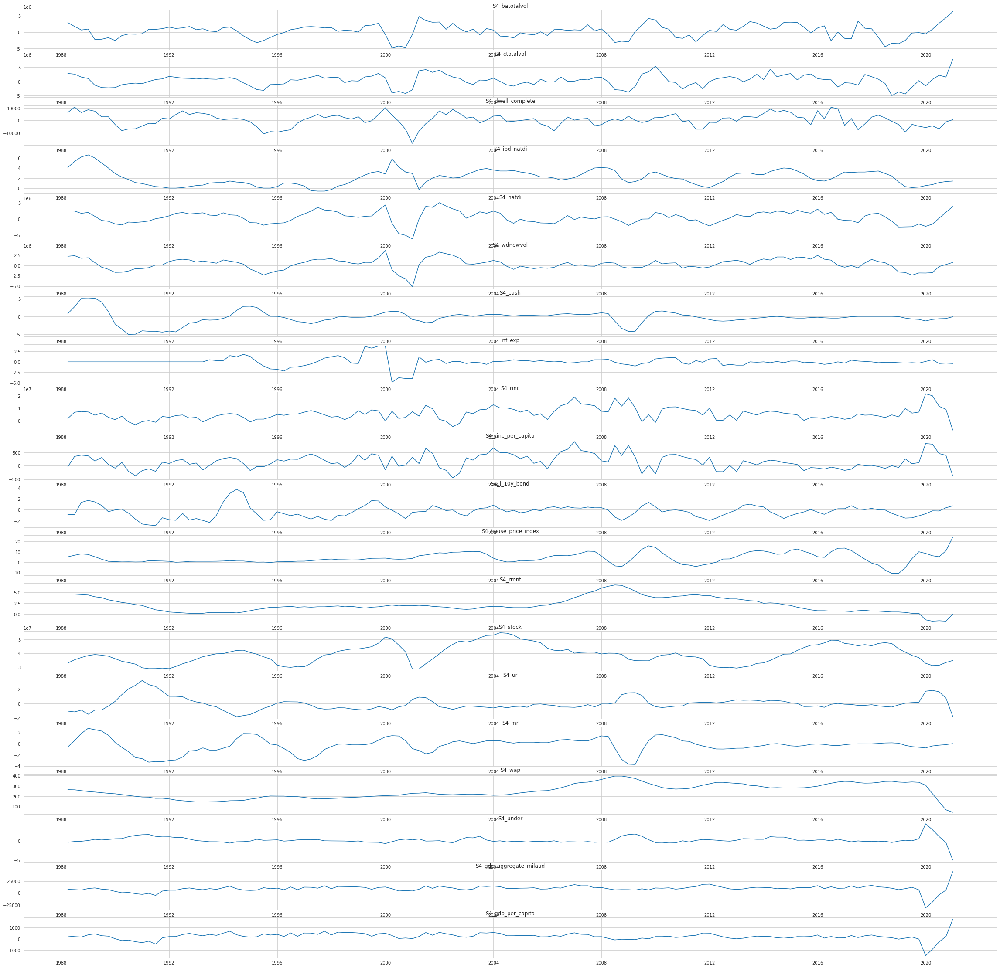

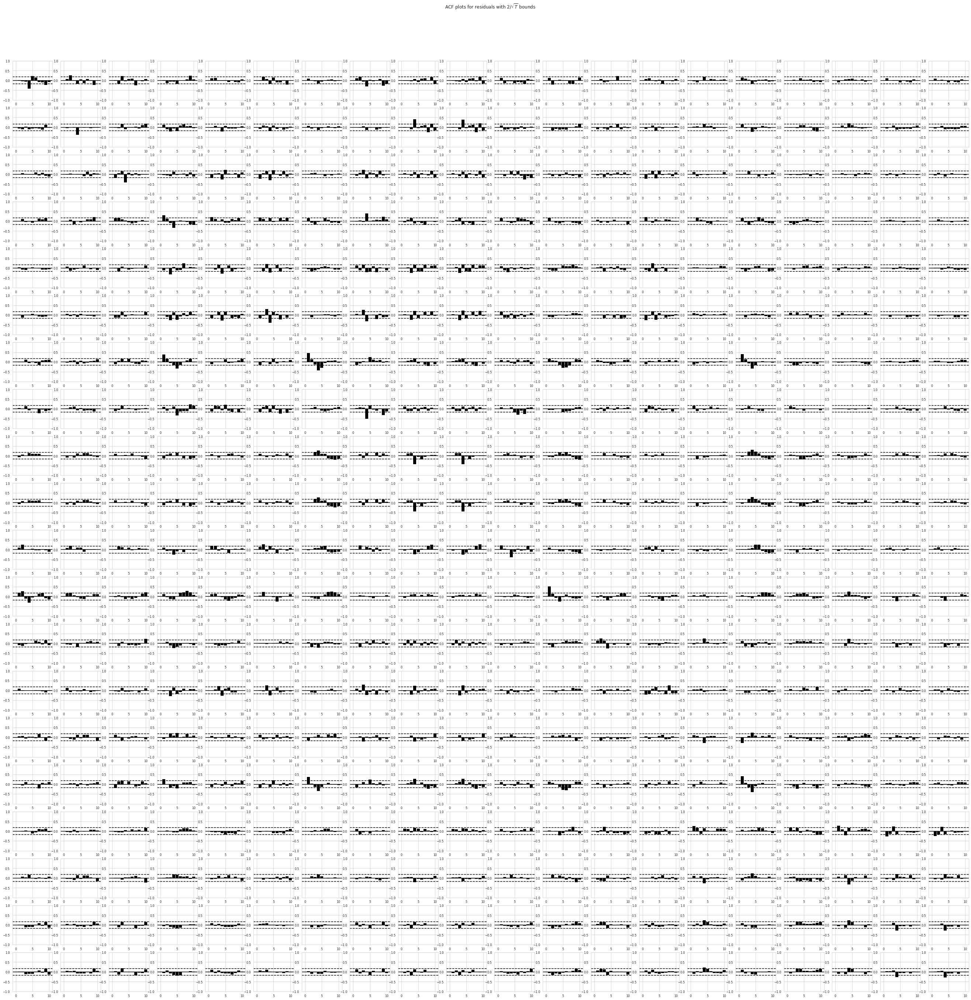

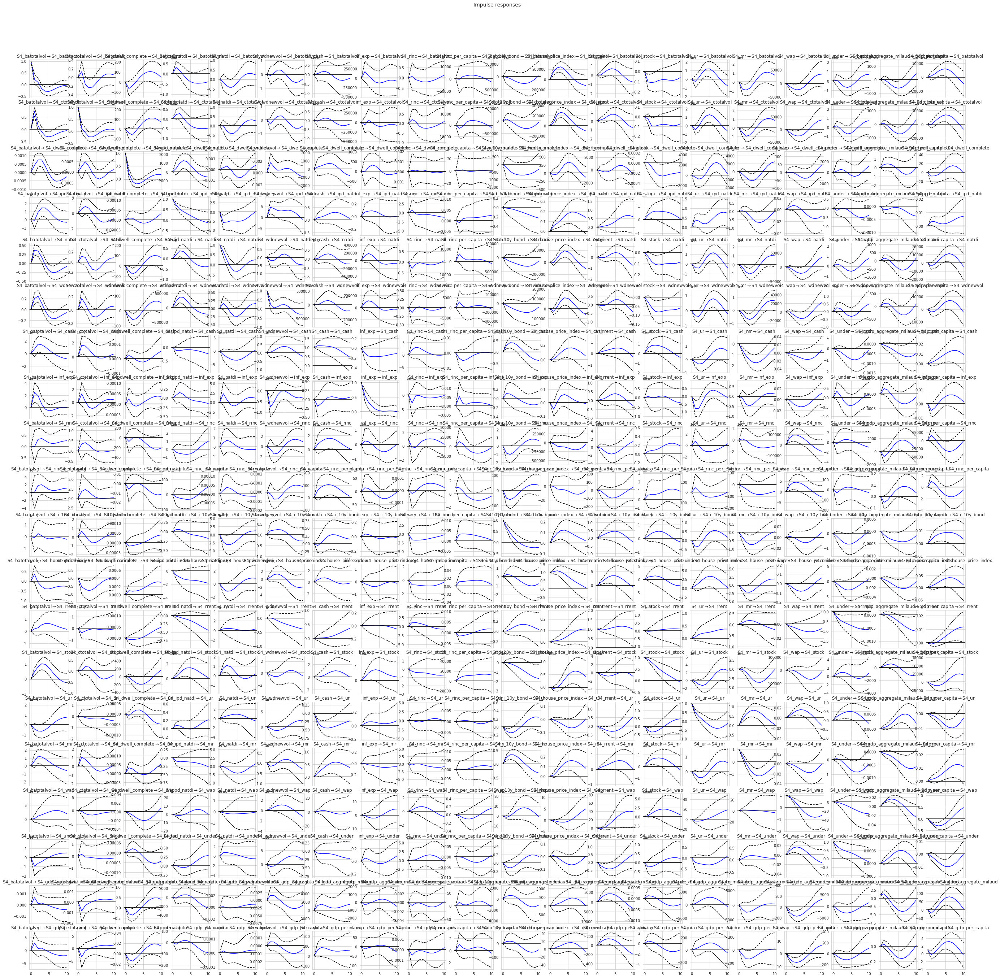

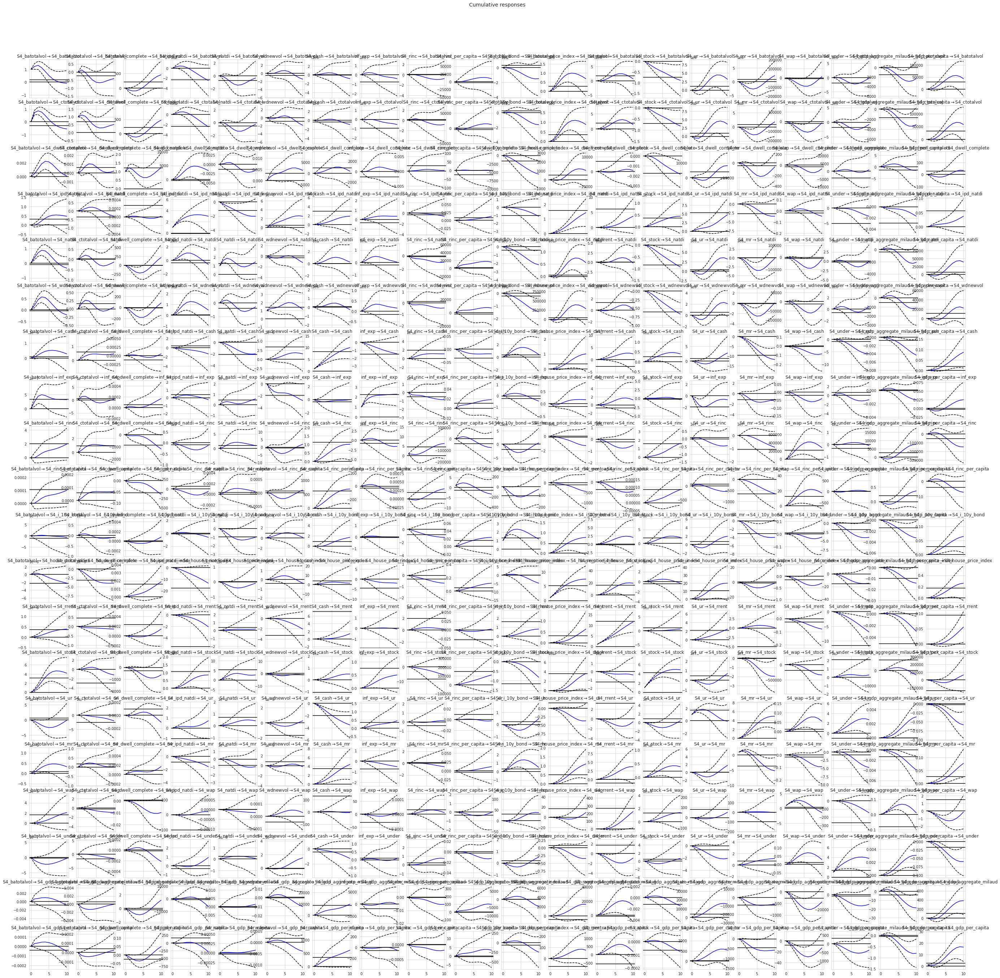

In [25]:
var_est(df, 1)

::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
VAR Result for maximum lag =2
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Fri, 12, Nov, 2021
Time:                     09:12:48
--------------------------------------------------------------------
No. of Equations:         20.0000    BIC:                    216.384
Nobs:                     130.000    HQIC:                   205.122
Log likelihood:          -15661.2    FPE:                9.12907e+85
AIC:                      197.414    Det(Omega_mle):     3.00865e+83
--------------------------------------------------------------------
Results for equation S4_batotalvol
                                coefficient       std. error           t-stat            prob
--------------------------------------

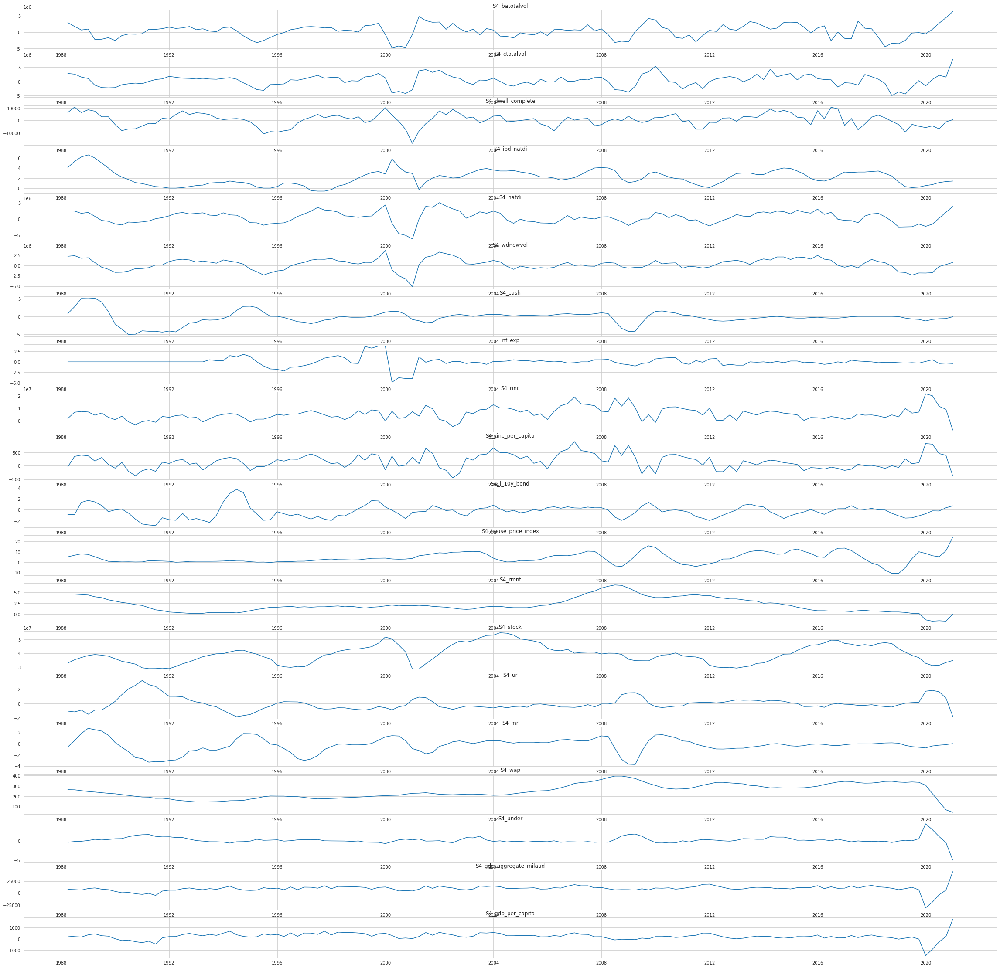

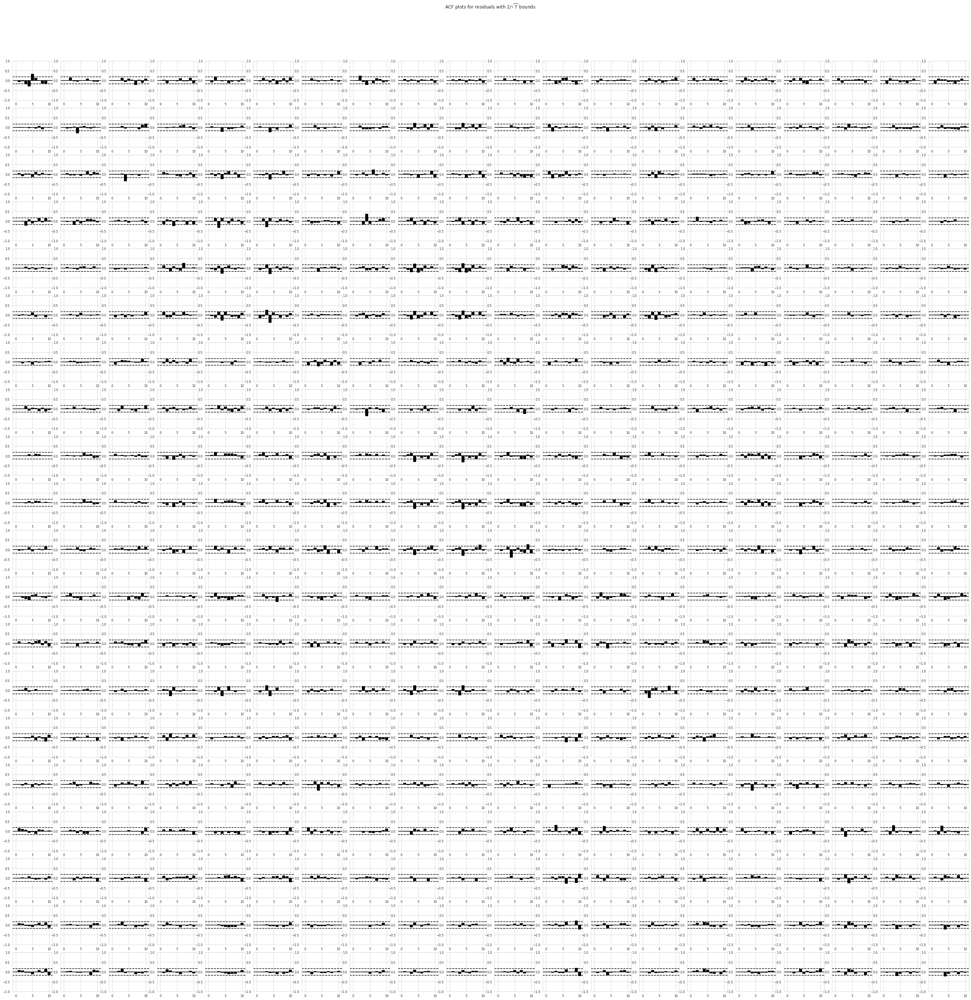

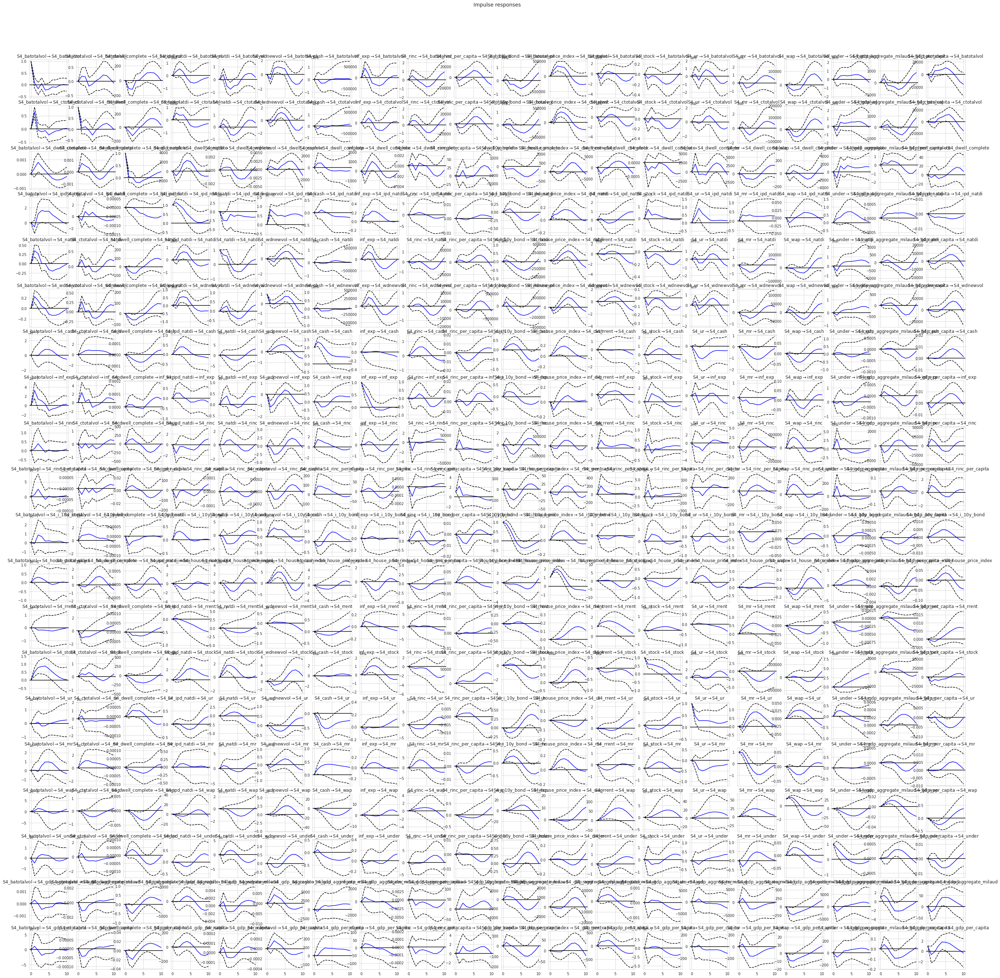

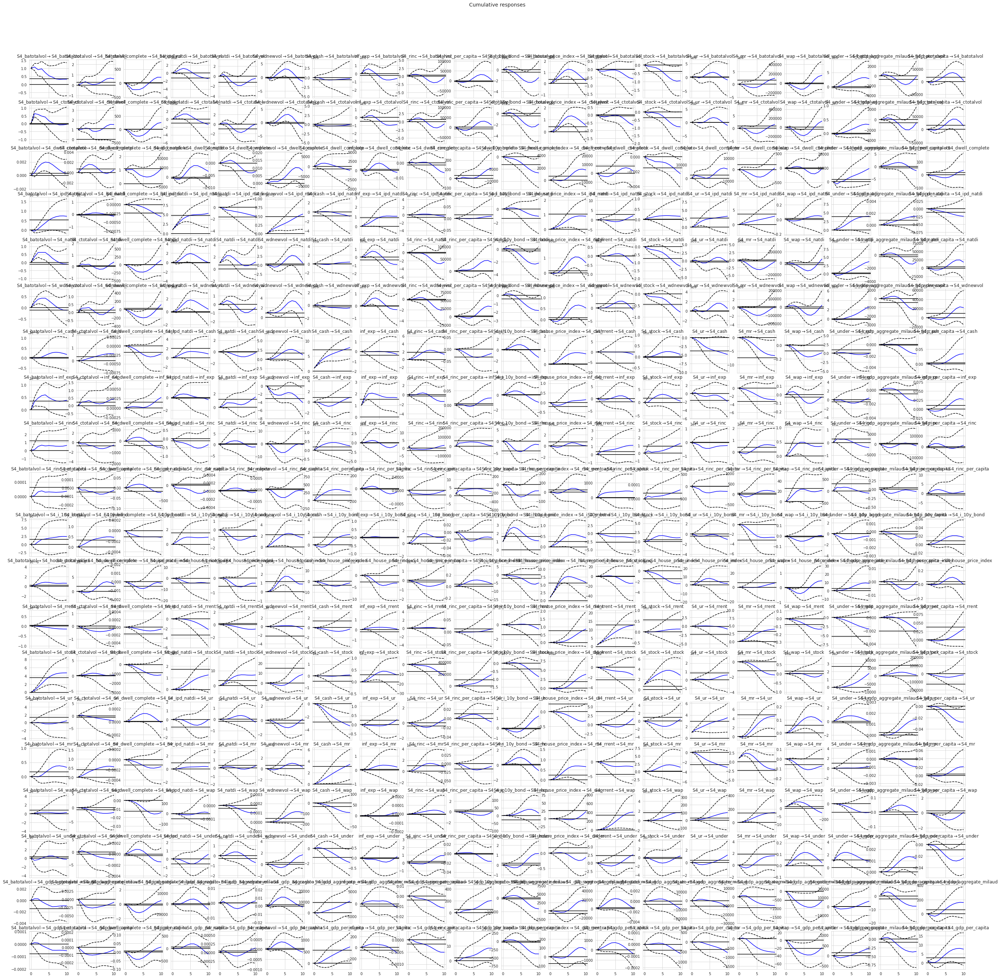

In [26]:
var_est(df, 2)

::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
VAR Result for maximum lag =3
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Fri, 12, Nov, 2021
Time:                     09:26:06
--------------------------------------------------------------------
No. of Equations:         20.0000    BIC:                    221.927
Nobs:                     129.000    HQIC:                   205.344
Log likelihood:          -14913.5    FPE:                1.10118e+85
AIC:                      193.994    Det(Omega_mle):     3.86925e+81
--------------------------------------------------------------------
Results for equation S4_batotalvol
                                coefficient       std. error           t-stat            prob
--------------------------------------

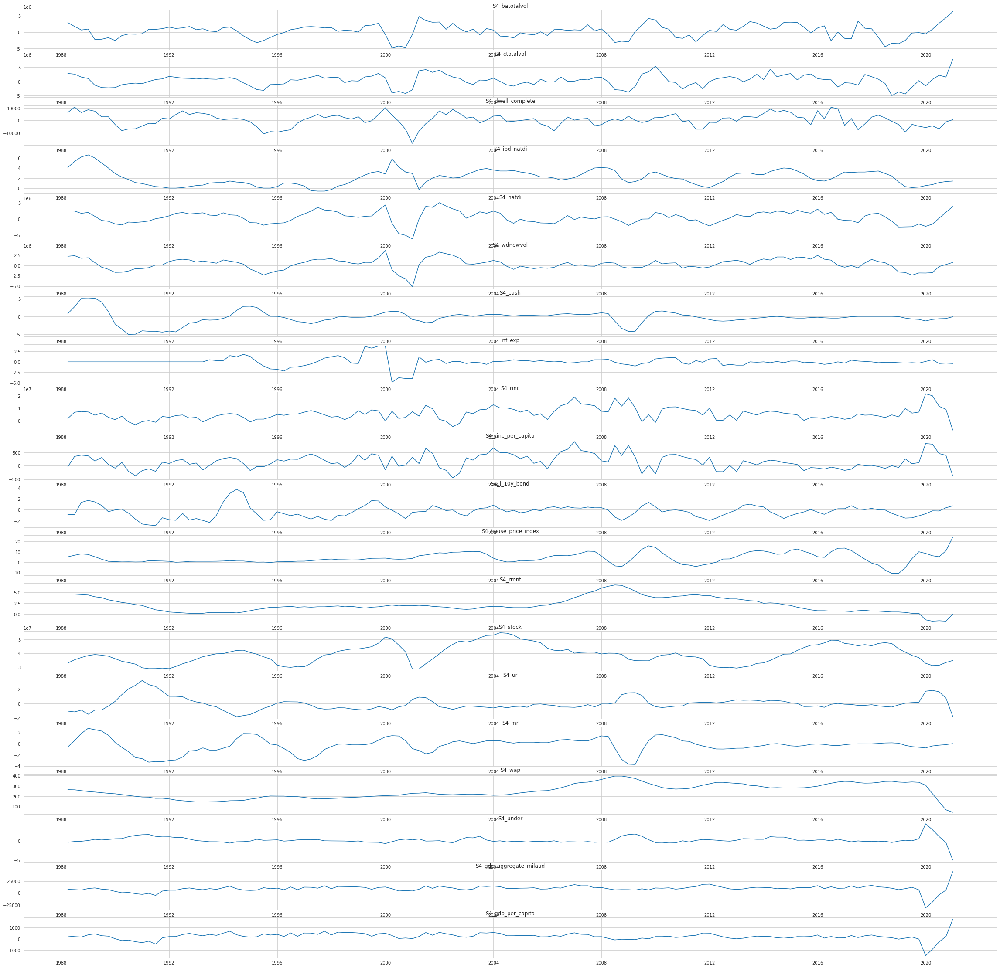

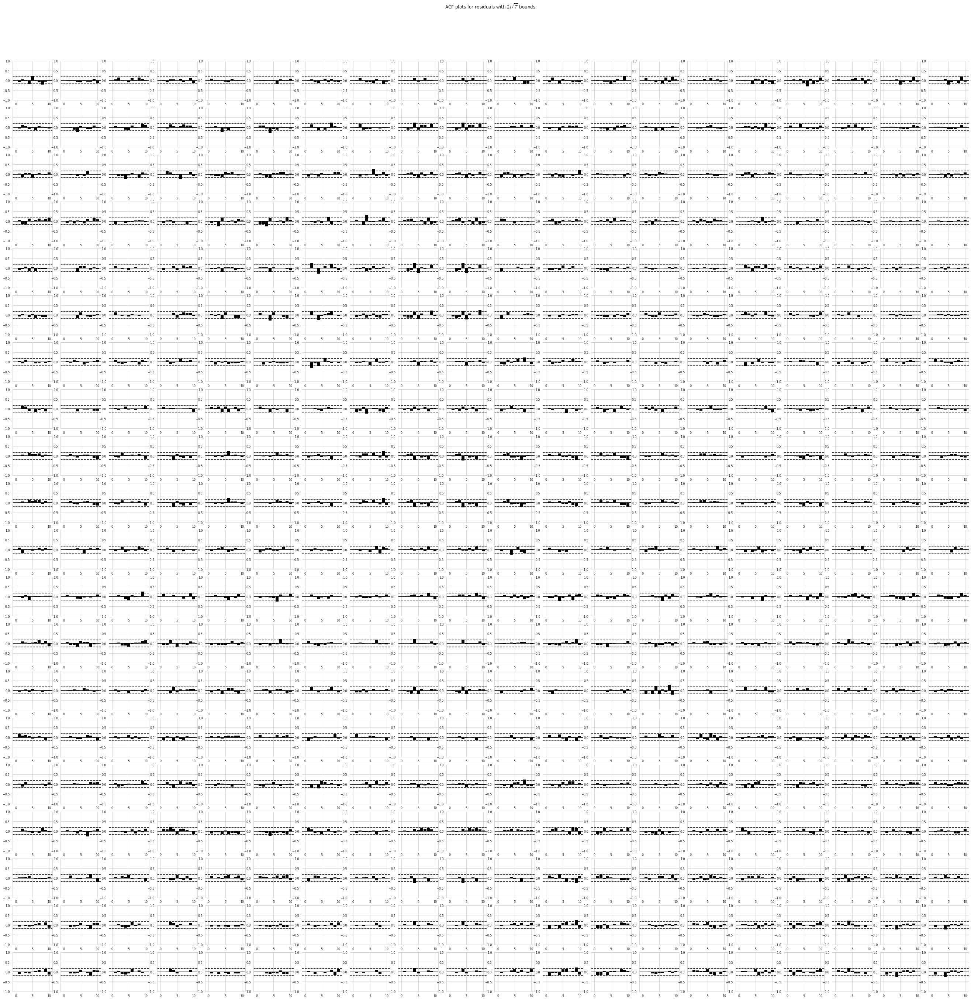

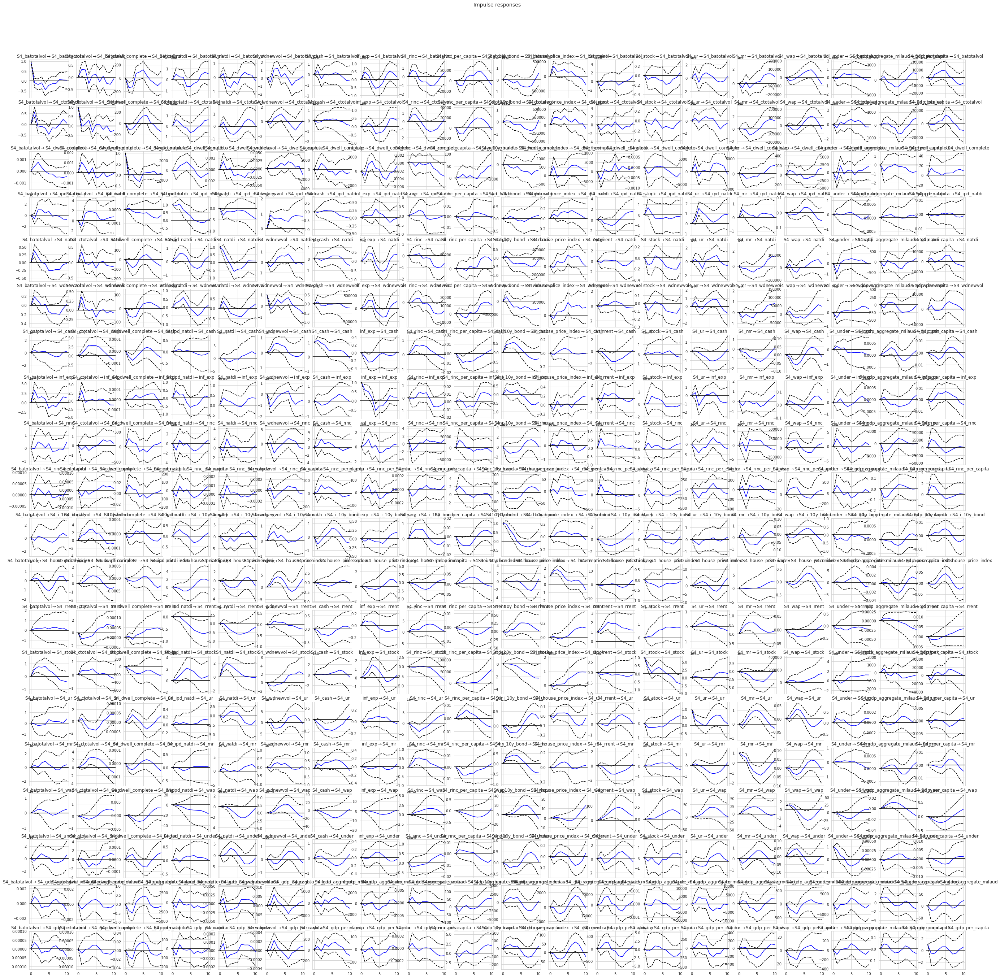

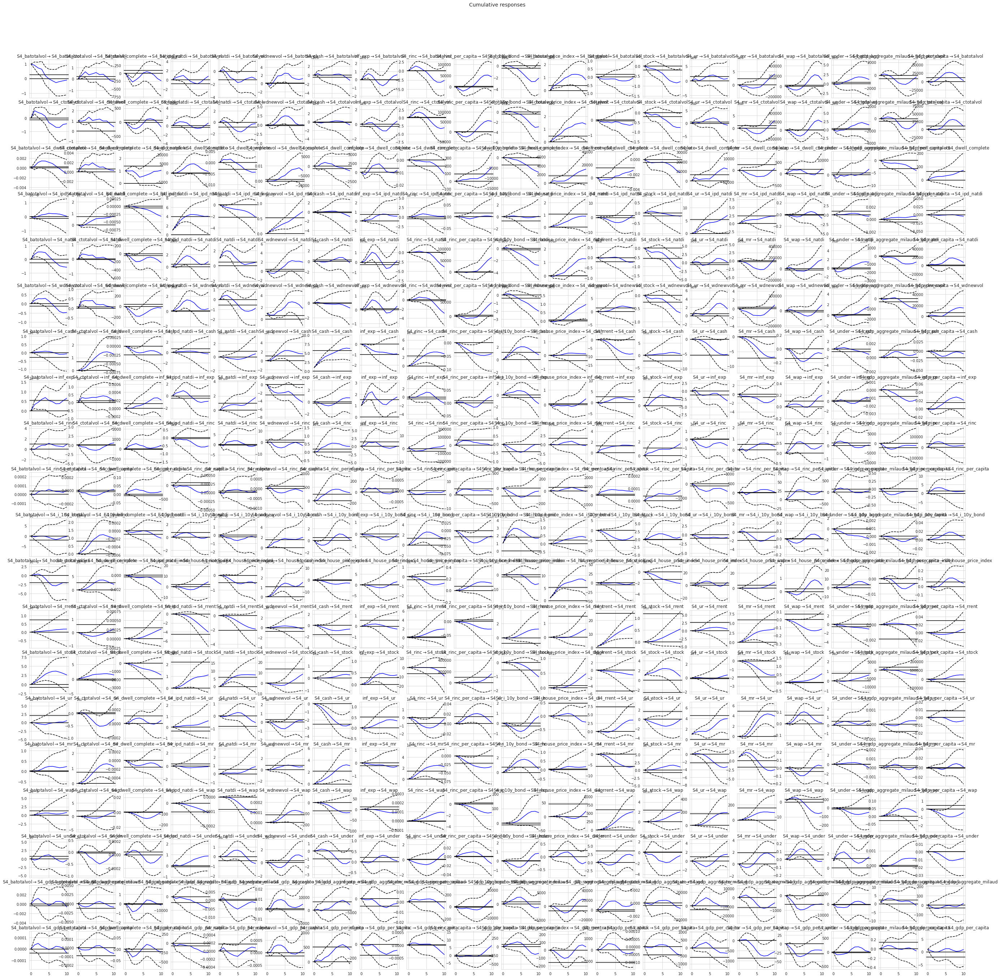

In [27]:
var_est(df, 3)

::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
VAR Result for maximum lag =4
::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::::
  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Fri, 12, Nov, 2021
Time:                     09:39:47
--------------------------------------------------------------------
No. of Equations:         20.0000    BIC:                    221.383
Nobs:                     128.000    HQIC:                   199.424
Log likelihood:          -13773.8    FPE:                1.73338e+82
AIC:                      184.396    Det(Omega_mle):     7.89668e+77
--------------------------------------------------------------------
Results for equation S4_batotalvol
                                coefficient       std. error           t-stat            prob
--------------------------------------

LinAlgError: ignored

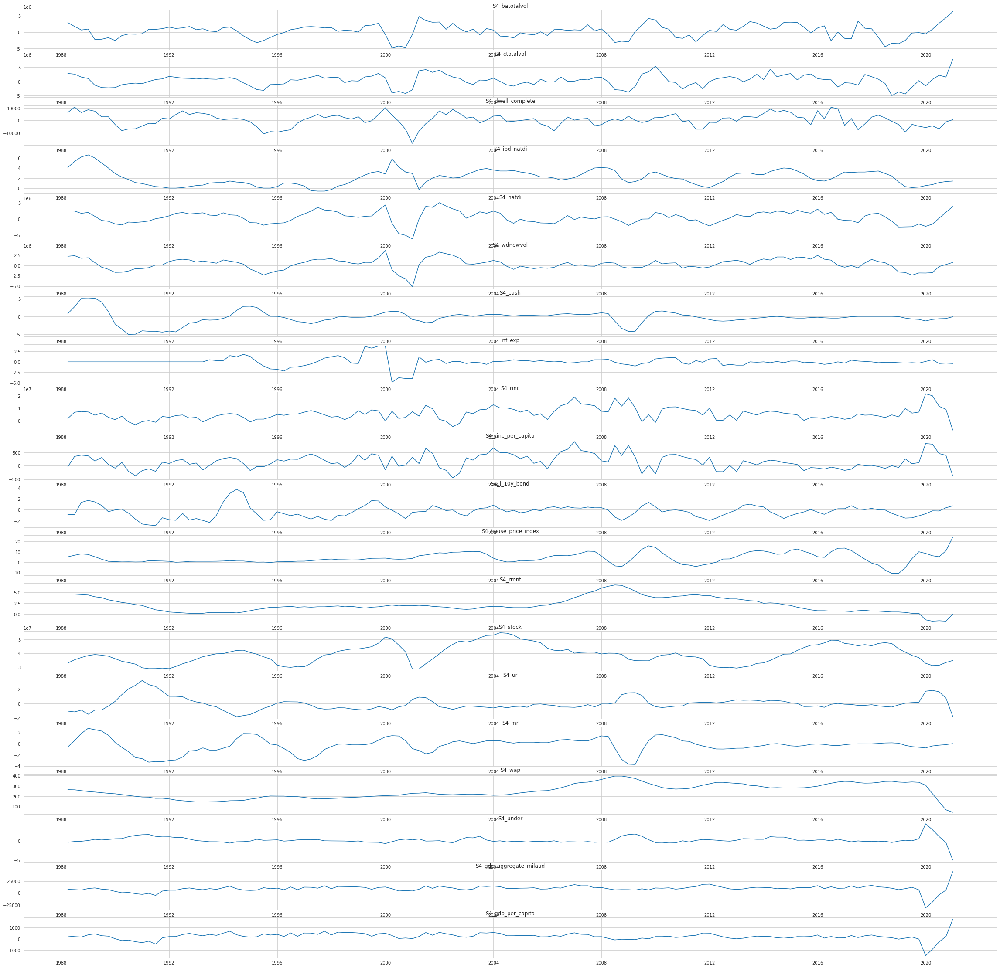

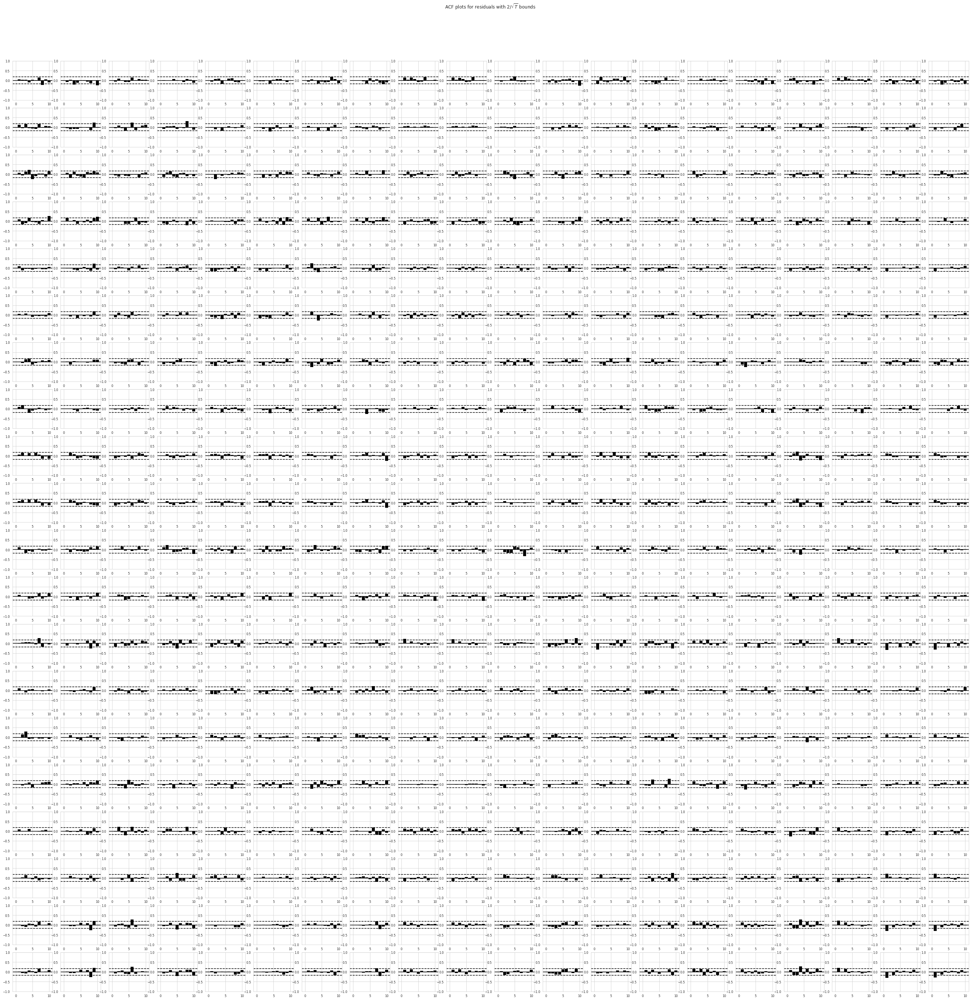

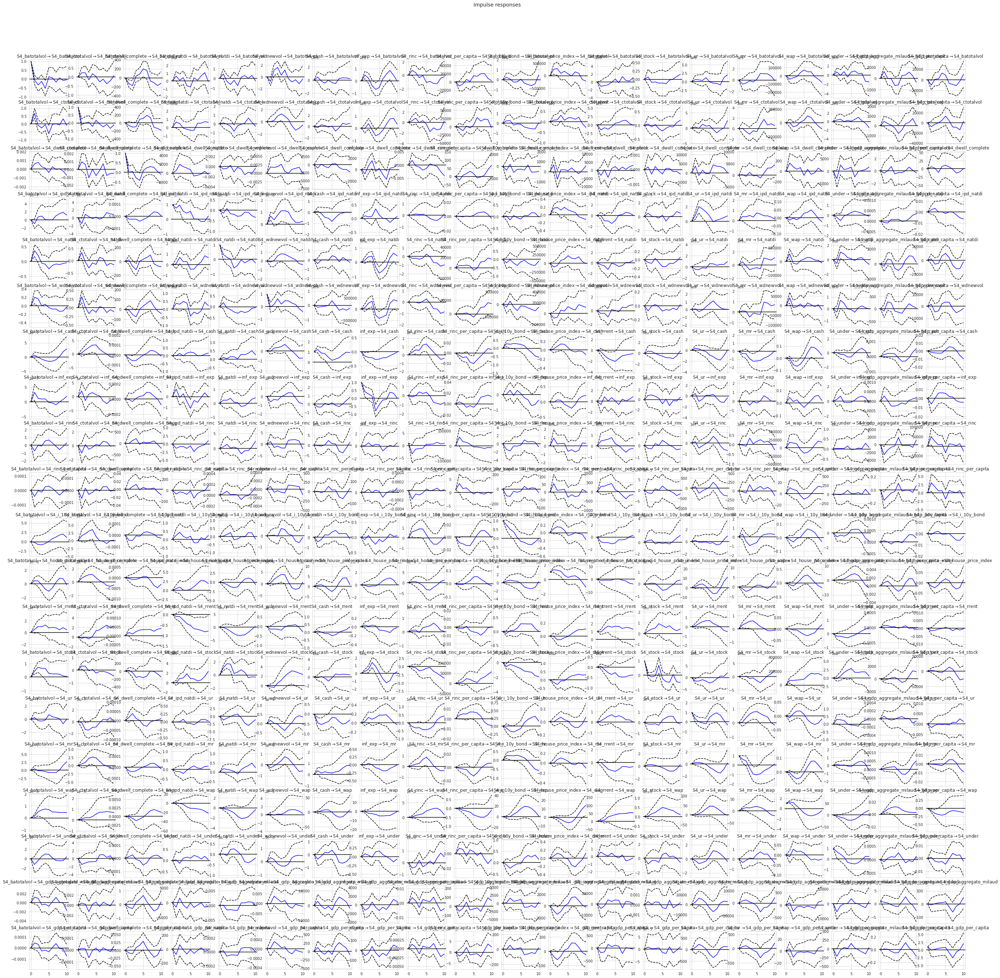

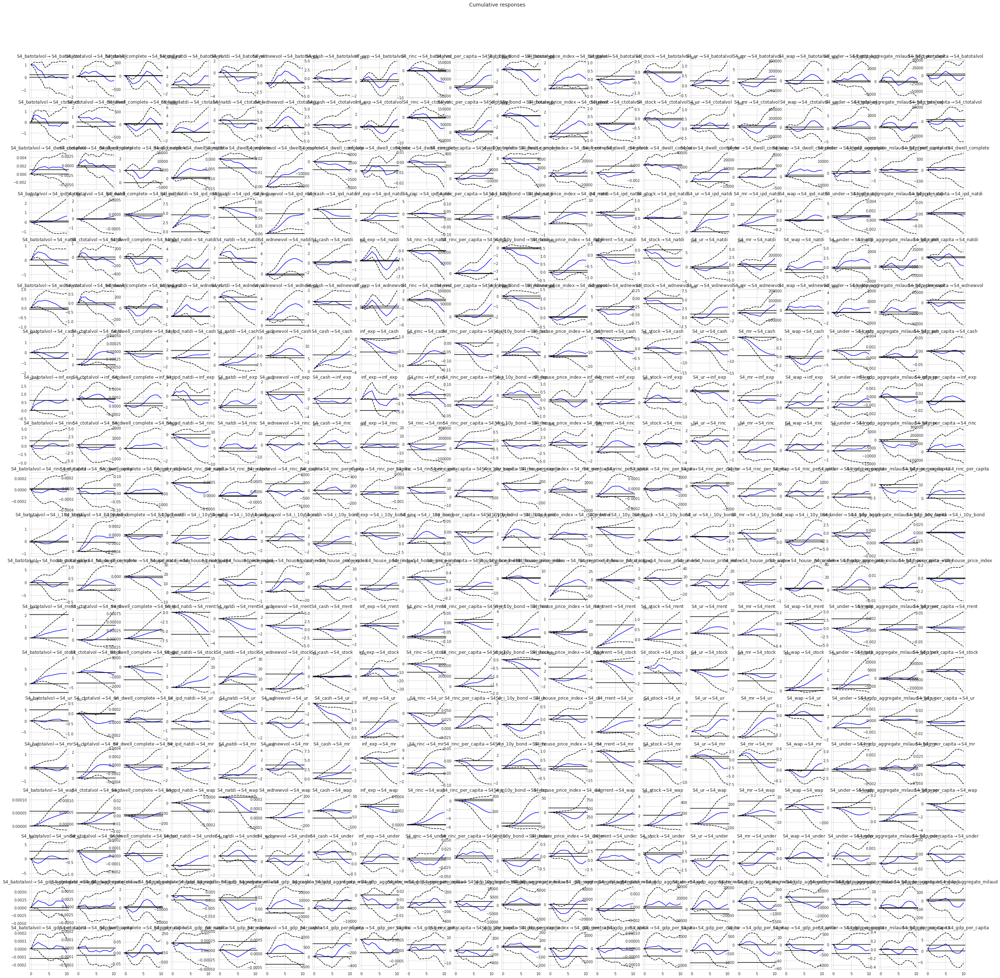

In [28]:
var_est(df, 4)

#We use the Bayesian Information Criterion to choose the model with the optimum number of lags. The lower the BIC, the more optimal the model. As we can see, the model with lag =1 has the lowest BIC. Therefore we can say that that is our model and lag value of choice.

In [34]:
# forecast_interval function produces the forecast along with asymptotic standard errors
model  = VAR(df)
result = model.fit(trend='ctt')
lag_order = result.k_ar
result.forecast_interval(df.values[-lag_order:],4)

(array([[ 1.05303762e+07,  1.04383493e+07,  2.75355077e+03,
          1.24586448e+00,  6.61025073e+06,  3.15245031e+06,
          1.60416438e+00,  2.16273089e+00, -1.75011060e+07,
         -9.33690965e+02,  2.60260381e+00,  3.34782122e+01,
          1.08255684e+00,  3.77291897e+07, -3.84245278e+00,
          1.39245946e+00,  8.02786180e+01, -6.49472589e+00,
          5.78149955e+04,  2.17406834e+03],
        [ 1.18809412e+07,  1.33093961e+07,  8.40264771e+03,
          1.88197332e+00,  9.67301458e+06,  5.43997627e+06,
          3.98025544e+00,  4.36540631e+00, -2.36013996e+07,
         -1.29357100e+03,  4.58317975e+00,  4.23679132e+01,
          2.30699320e+00,  4.41486838e+07, -5.71921890e+00,
          3.52081816e+00,  1.46867075e+02, -7.46215925e+00,
          6.87449536e+04,  2.55055856e+03],
        [ 1.12377858e+07,  1.34463872e+07,  1.39325247e+04,
          3.31689389e+00,  1.13633241e+07,  6.86092002e+06,
          6.64396864e+00,  5.76374265e+00, -2.56422091e+07,
         -1.

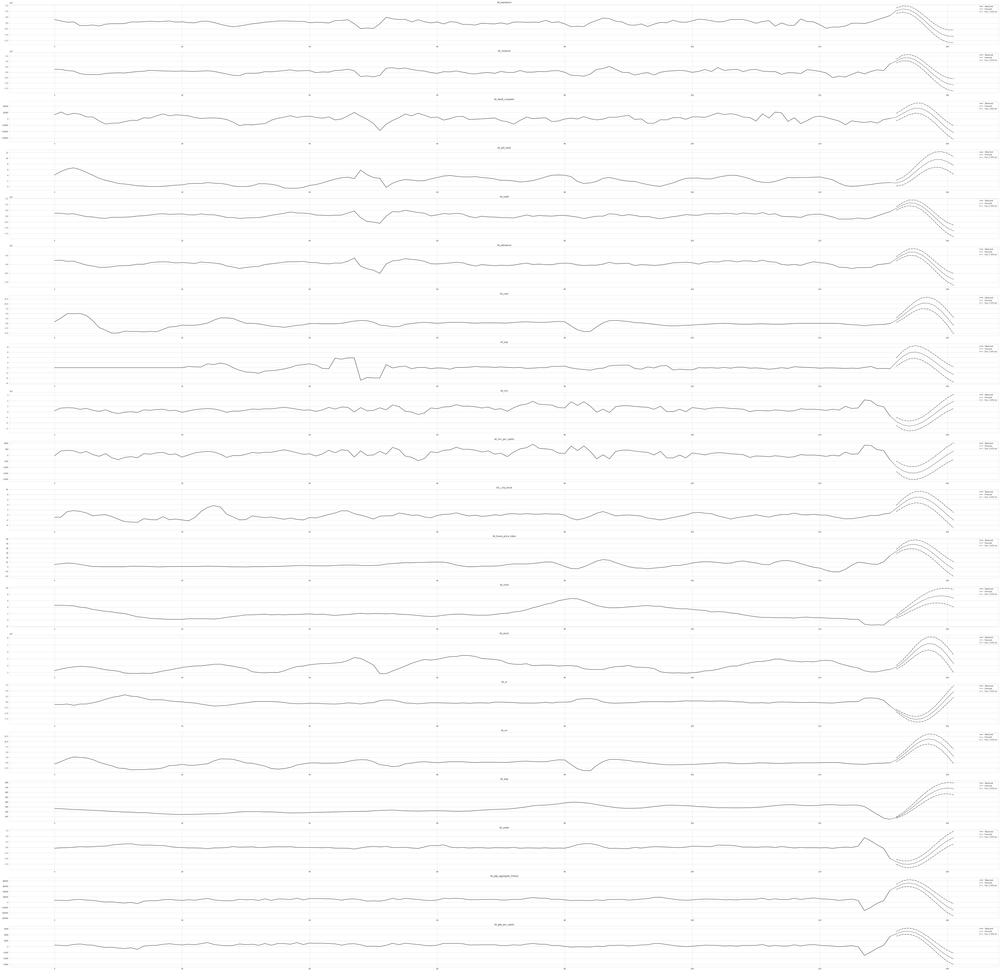

In [38]:
#Visualising the forecast
forecast = result.plot_forecast(10)
forecast.set_figheight(100)
forecast.set_figwidth(100)


In [47]:
print(result.test_normality())

<statsmodels.tsa.vector_ar.hypothesis_test_results.NormalityTestResults object. H_0: data generated by normally-distributed process: reject at 5% significance level. Test statistic: 538.903, critical value: 55.758>, p-value: 0.000>
